<a href="https://colab.research.google.com/github/matteo9924/Challenge_Rats_New_York/blob/main/Code_Rats.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#                                        **Compte rendu projet groupe 12**

# 1. **Business Understanding**

## 1.1. **Contexte:**

  La régulation des populations de rats est un problème connu depuis longtemps qui touche toutes les grandes villes. Jadis leur présence était synonyme de mort, puisqu’ils étaient porteurs du bacille de la peste, qui a tué des millions de personnes. Aujourd’hui, même si la peste a quasiment disparu de nos contrées, leur présence cause toujours des problèmes : ils sont toujours vecteurs de zoonoses comme la leptospirose, la rage, et beaucoup d’autres. En outre, s’ajoute à ce problème les dégâts matériels qu’ils causent. En effet, ils ont besoin de ronger des choses pour utiliser leurs dents, et dans un environnement urbain, ils sont capables de tout ronger même le béton. Ils rongent les câbles électriques, ce qui peut causer des incendies, ou courts-circuits, les plafonds, sols, murs, et même les fondations d’immeubles, ce qui peut causer leurs affaissements. La présence de rats est également associée à l’insalubrité. 

C’est pour ces raisons que le maire de New York a annoncé en 2017 un plan de 32 millions de dollars pour dératiser la ville. 

Réaliser une dératisation a un coût, et lorsqu'il s'agit de dératiser une ville, il faut des moyens faramineux. Il paraît alors normal de chercher à dératiser plus intelligemment afin de réduire les coûts et c'est dans cette optique que la Mairie de New York nous a contacté en tant que Data Scientists. 

Si la mairie de New York nous a contacté, c'est parce qu'elle sait que l'analyse de données permet de mieux comprendre les raisons de présence des rats : en ayant une approche statistique, nous pouvons trouver différents facteurs à l'origine de la présence de rats, qui n'auraient pas forcément été mis en lumière par des approches traditionnelles. Dans ce cadre là nous avons pu déterminer l’objectif de la mission ainsi que la problématique à laquelle il faudra répondre.

**Objectif :**
Effectuer des recommandations à la mairie de New York sur la politique à mener vis-à-vis des restaurants, des lieux de dépôts de compost, et du ramassage des déchets.

**Problématique :**
La présence de rats à un endroit peut elle être expliquée par la présence de restaurants à proximité ? Comment agir alors pour diminuer la présence de rats ? 




# 2.   **Data understanding**
Pour cela nous allons utiliser un certain nombre de datasets présentés ci-dessous. 
## Présentation des Datasets 

### Dataset concernant la présence de rats à Manhattan et ses environs :



In [ ]:
### Import des bibliothèques et des données 

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

import sklearn
from sklearn.model_selection import train_test_split
from sklearn import tree
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error



In [ ]:
rats=pd.read_csv("/content/Rat_Sightings.csv",sep=";")#[:max_size]
rats['Created Date']=pd.to_datetime(rats['Created Date']).dt.to_period('M')
rats = rats.dropna(subset=['Location'])
rats.head()


,Unique Key,Created Date,Incident Zip,Facility Type,Borough,Latitude,Longitude,Location
0,48005710,2020-10,10128.0,NaN,MANHATTAN,40.780608,-73.952695,"(40.78060823292779, -73.95269467250661)"
1,48006851,2020-10,11221.0,NaN,BROOKLYN,40.694134,-73.933813,"(40.69413372255258, -73.93381299745931)"
2,48008114,2020-10,11221.0,NaN,BROOKLYN,40.693588,-73.934167,"(40.6935877164801, -73.93416693788255)"
3,48007917,2020-10,11216.0,NaN,BROOKLYN,40.691903,-73.946851,"(40.69190349525408, -73.94685095525908)"
4,48008010,2020-10,11238.0,NaN,BROOKLYN,40.683089,-73.958291,"(40.6830892609302, -73.95829114129134)"


### Dataset contenant les lieux de points de composts 
Il indique le lieu et les dates d'ouvertures des batiments possédant des poubelles alimentaires importantes (restaurants, cantines, cafettes etc). La liste est actualisée (2020) et provient d'une base de données trouvée sur le site officiel de la ville de New York. Il n'y en a que 100 recensés pour Manhattan et ces environs.
Les limites de ce dataset sont qu'on ne connait pas la quantité de déchets journaliers de ces batiments ni la date de leur implantation.

Il se présente de cette façon :

In [ ]:
food_bin1= pd.read_csv("/content/Food_drop_off.csv")

#suppression colonnes inutiles 
food_bin1.drop(food_bin1.columns[[1,2,3,4,8,9,10,11,13,14,15,16,17]], axis='columns',inplace=True)

#On change le type de la colonne zipCode. C'est actuellement un str et on veut un float. Il faut se débarrasser de la virgule.
foodArray = food_bin1.to_numpy()

for i in range (len(foodArray)):
  zip = foodArray[i][5][0:2]
  zip +=foodArray[i][5][3:]
  zip +='.0'
  foodArray[i][5]=float(zip)
food_bin = pd.DataFrame(foodArray,columns = food_bin1.columns)
food_bin

,Borough,Latitude,Location,Longitude,Open_Months,zip_code
0,Bronx,40.8096,494 East 141 St.,-73.9187,Year Round,10454
1,Bronx,40.84,"Townsend Ave & 170 St, Bronx",-73.9168,"Seasonal Market, July-November",10452
2,Manhattan,40.7556,5 Hudson Blvd East,-74.0004,Year Round,10001
3,Staten Island,40.6302,"97 Myrtle Avenue, Staten Island, NY",-74.116,"Seasonal, March-November",10310
4,Brooklyn,40.6355,6753 4th Avenue,-74.0228,Year Round,11220
...,...,...,...,...,...,...
243,Bronx,40.8212,670 Grand Concourse,-73.925,"Seasonal, April-October",10451
244,Manhattan,40.7904,270 West 89th Street,-73.976,Year Round,10024
245,Queens,40.7724,"14-01 Astoria Blvd, Astoria, NY 11102",-73.9287,Year Round,11102
246,Manhattan,40.782,Columbus Avenue and 79th Street,-73.9755,Year Round,10024


### Dataset sur la quantité d'ordures ramassées


Il nous indique la quantité de déchets réupérée mensuellement par quartier.

La limite de ce dataset est que l'on ne connait pas plus précisément que le quartier l'emplacement de ces points de collectes.

Il se présente de telle façon :

In [ ]:
bin = pd.read_csv("/content/DSNY_Monthly_Tonnage_Data.csv",sep=";")
#suppresion des colonnes inutiles
bin.drop(bin.columns[[2,6,7,8,9,10]], axis='columns',inplace=True)

#suppression des données pré-2018

bin_array=bin.to_numpy()
real_bin_array=[]
for i in range(0,len(bin_array)):
  if bin_array[i][0][0]=='2':
    if bin_array[i][0][2]=='1':
      if bin_array[i][0][3]=='8' or bin_array[i][0][3]=='9':
        real_bin_array.append(bin_array[i])
    elif bin_array[i][0]=='2':
      real_bin_array.append(bin_array[i])

correct_bin= pd.DataFrame(real_bin_array, columns= bin.columns)
correct_bin

,MONTH,BOROUGH,REFUSETONSCOLLECTED,PAPERTONSCOLLECTED,MGPTONSCOLLECTED
0,2018 / 07,Brooklyn,3375.8,424.6,395.0
1,2019 / 10,Brooklyn,3342.5,418.4,415.4
2,2019 / 08,Brooklyn,3263.2,399.4,408.1
3,2019 / 02,Staten Island,4392.4,638.3,586.1
4,2018 / 11,Staten Island,5757.3,845.8,713.4
...,...,...,...,...,...
1411,2018 / 02,Bronx,1723.0,112.4,151.5
1412,2019 / 05,Bronx,1985.8,127.7,195.9
1413,2019 / 02,Bronx,1921.2,117.2,167.9
1414,2018 / 10,Bronx,2281.1,145.2,215.7


### Dataset sur la population
Il contient le nombre d'habitants par "zipcode" (code postal) au recensement de 2018 et se présente comme ceci : 

In [ ]:
pop=pd.read_csv("/content/popzips.csv", sep=";")
pop.head()

,zipcode,population
0,10001,22924
1,10002,74993
2,10003,54682
3,10004,3028
4,10005,8831


### Dataset sur les restaurants 
 Pour ce dataset, nous avons un dataset très volumineux, et nous devons donc le réduire. Il s'agit du dataset "Restaurants_inspections.csv". Nous avons effectué des changements directement sur le fichier csv, ce afin qu'il s'ouvre plus facilement. Nous gardons ce fichier avec toutes ces informations qui nous serviront plus tard et n'utilisons pour l'instant qu'un dataset que nous avons construit et qui contient le nombre restaurants par zipcode. La justification de ce choix est faite plus loin dans ce document.


In [ ]:
restaurants= restaurants=pd.read_csv("/content/Restaurants_inspections.csv",sep=";")
restaurants.dropna(subset=["Latitude","Longitude"],inplace=True)
restaurants = restaurants[~(restaurants == 0).any(axis=1)] 
#restaurants["Location"]=list(zip(restaurants.Longitude,restaurants.Latitude))
restaurants.rename(columns={'CAMIS': 'id'}, inplace = True)

restaurants.head()

FileNotFoundError: ignored

In [ ]:
##datasets des restaurants par zipcode :
import pandas as pd 
restZips= pd.read_csv("/content/restaurants_zipcodes.csv",sep=",")
restZips.head()

,ZIPCODE,count_restaurants
0,10000.0,2
1,10001.0,544
2,10002.0,556
3,10003.0,707
4,10004.0,155


## Analyse statistique sur les données
Les données portant essentiellement sur des positions géographiques, il convient de commencer par représenter les données. 


La première étape est de visionner naïvement les données, à savoir représenter chaque donnée par un point positionné sur une carte de New York. Le code est disponible dans le fichier "mapping.py", et la carte en résultant est disponible dans le fichier " map.html " (trop lourd pour être lu par le notebook). (légende : vert = compost, rouge = rat, bleu = restaurant) 

On comprend facilement qu'une représentation comme ça ne va pas être très utile. Cherchons donc un moyen de représenter les données de manière plus " efficace ". 

Intéressons nous d'abord à la variable à expliquer, à savoir la répartition de la présence de rats à l'extérieur 

Une option est de dessiner une carte de chaleur de la population de rats. Le résultat est disponible dans le fichier " HeatMap.html" (trop lourd pour être lu par le notebook) 

Nous voyons que la présence de rats n'est pas uniforme. Cela permet de justifier que la répartition de la présence de rats n'est pas anodine et qu'elle doit pouvoir s'expliquer par un facteur extérieur. 
Cette représentation ne prend pas en compte la date à laquelle les rats ont été vus. 
Un moyen de prendre en compte cette donnée est d'utiliser une carte de chaleur temporelle. Le resultat est disponible dans le fichier "HeatMap time.html". A chaque "frame" correspond un trimestre. Outre quelques valeurs abérantes (premières "frames" sur lesquelles il n'y a que quelques données), nous pouvons voir que de trimestre en trimestre la population de rat est toujours repérée aux mêmes endroits environ, malgré quelques exceptions. Cela nous permet de comprendre que la présence des rats est un problème récurrent dans certains endroits de la ville, peu importe la date. 

Cela nous permet d'affirmer que l'on peut travailler à une certaine echelle plutôt que point par point. Il nous faut alors trouver une échelle convenable. Ni trop grande car cela applatirait les irrégularités, ni trop petite car cela créerait des disparités. Par ailleurs il faut une échelle sur laquelle nous avons des données. 
Le "zipcode" est une échelle qui répond à tous ces critères, et nous travaillerons donc désormais sur le zipcode. 

Commençons donc par représenter les données de la présence de rats par zipcode.


In [ ]:
%run "/content/Chloropeth.py"
map



(les cases où il manque des données sont en noir) 

Nous pouvons clairement voir qu'il existe des disparités entre les différentes zones et que cette échelle est une bonne échelle pour notre travail. A partir de maintenant nous allons plus travailler sur les zipcodes que sur les localisations précises. 

L'intérêt est donc de comprendre par zipcode pourquoi les données sur la population de rat varient. 

Enfin, nous pouvons déterminer si il y a des " types " de zipcodes en fonction du nombre de rats qu'elles contiennent. A partir de ce moment là, nous auront un premier outil à donner à la ville de New York : si l'on a des types de zipcodes différents, alors il est facile de voir si dans le futur un zipcode passe d'un type à un autre, et nous pouvons donc donner un seuil d'alerte sur le nombre de rats. En effet si un zipcode dépasse ce seuil, il faudra être particulièrement vigilant sur ce zipcode et appliquer d'autant plus les recommandations issues de cette étude sur celui-ci. 

Nous pouvons maintenant travailler sur les zipcodes (et par ailleurs représenter différentes données par zone )



In [ ]:
### Par exemple, représentons le rapport Rats/Humains par zipcode 
%run "./Choropleth2.py"
map

Intéressons nous donc à comment parititionner les zones en fonctions du nombre de rats. Il s'agit donc d'utiliser un algorithme de clustering pour déterminer le nombre de partitions optimal du nombre de rats par zipcodes.


In [ ]:
%run "./clustering.py"

Nous aurons donc trois types de zipcodes : les zipcodes avec une population de rats faible, modérée, et critique priorisant ainsi les zipcodes dans lesquels il faut absolument dératiser. Construisons maintenant un dataset sur les zipcodes qui nous permettra d'avoir un seul jeu de données et qui nous permettra de connaître les coefficients de corrélation entre la présence de rats et d'autres facteurs. 

## Construction du nouveau dataset 



In [ ]:
import pandas as pd
restaurants=pd.read_csv("/content/restaurants_zipcodes.csv",sep=",")
population= pd.read_csv("/content/popzips.csv",sep=";")

rats=pd.read_csv("/content/Rat_Sightings.csv",sep=";")#.dropna()
rats.rename(columns={'Incident Zip': "zipcode", 'Unique Key':'id'}, inplace = True)

rats_zipcodes = rats.groupby('zipcode').count().id

zips=pd.DataFrame()

zips["zipcode"]=[float(i) for i in rats_zipcodes.index]
zips["count_rats"]=rats_zipcodes.values
zips=zips.join(population.set_index('zipcode'), on ="zipcode").dropna()
zips = zips[~(zips == 0).any(axis=1)] 
zips["ratsperH"]=zips["count_rats"]/zips["population"]
#zips["restaurants"]=zips.join(restaurants.set_index('ZIPCODE'), on="zipcode",how="right")
zips=zips.merge(restaurants,left_on='zipcode', right_on='ZIPCODE')
zips

,zipcode,count_rats,population,ratsperH,ZIPCODE,count_restaurants
0,10001.0,580,22924.0,0.025301,10001.0,544
1,10002.0,1845,74993.0,0.024602,10002.0,556
2,10003.0,921,54682.0,0.016843,10003.0,707
3,10004.0,67,3028.0,0.022127,10004.0,155
4,10005.0,50,8831.0,0.005662,10005.0,72
...,...,...,...,...,...,...
175,11691.0,364,67094.0,0.005425,11691.0,46
176,11692.0,99,20991.0,0.004716,11692.0,14
177,11693.0,81,12919.0,0.006270,11693.0,36
178,11694.0,138,21354.0,0.006462,11694.0,47


In [ ]:
food_bin.columns


Index(['Borough', 'Latitude', 'Location', 'Longitude', 'Open_Months',
       'zip_code'],
      dtype='object')

In [ ]:
food_bin.rename(columns = {"Borough":"count_bins","zip_code":"zipcode"},inplace=True)

food_bin_zipCode1 = food_bin.groupby('zipcode')['count_bins'].count()

#On rajoute des colonnes pour les districts qui n'ont pas de restaurant recensé
food_bin_zipCode=pd.DataFrame()
food_bin_zipCode["zipcode"]=[float(i) for i in food_bin_zipCode1.index]
food_bin_zipCode["count_bins"]=food_bin_zipCode1.values
food_bin_zipCode = food_bin_zipCode[~(food_bin_zipCode == 0).any(axis=1)] 

compteur = 10001.0
i=0
j=0
boole=False
for col_name, data in food_bin_zipCode.items():
  if col_name=='zipcode':
    for j in range(38):
      if data[j] != compteur+j:
        #print(data[j],' ,', compteur+j)
        k=0
        while data[j]!=compteur+j+k:
          food_bin_zipCode.loc[food_bin_zipCode.shape[0]+j+k] = [compteur+j+k, 0]
          k+=1
        compteur+=k
          
food_bin_zipCode = food_bin_zipCode.sort_values('zipcode')
food_bin_zipCode.head(90)

#on fusionne les 2 datasets sur la colonne zipCode
zips1 = zips.merge(food_bin_zipCode,left_on='zipcode',right_on='zipcode')

zips1


,zipcode,count_rats,population,ratsperH,ZIPCODE,count_restaurants,count_bins
0,10001.0,580,22924.0,0.025301,10001.0,544,3.0
1,10002.0,1845,74993.0,0.024602,10002.0,556,8.0
2,10003.0,921,54682.0,0.016843,10003.0,707,7.0
3,10004.0,67,3028.0,0.022127,10004.0,155,4.0
4,10005.0,50,8831.0,0.005662,10005.0,72,0.0
...,...,...,...,...,...,...,...
99,11377.0,1349,86421.0,0.015610,11377.0,223,1.0
100,11415.0,93,19372.0,0.004801,11415.0,37,1.0
101,11435.0,718,59296.0,0.012109,11435.0,117,1.0
102,11691.0,364,67094.0,0.005425,11691.0,46,1.0


In [ ]:
tree1=pd.read_csv("/content/trees_NY.csv",sep=";")
tree1.drop(tree1.tail(1).index,inplace=True)
tree1

,zipcode,Number_tree,count_bin2,count_park
0,10001,911,3,5
1,10002,2265,8,28
2,10003,2025,7,12
3,10004,118,4,2
4,10005,144,0,1
...,...,...,...,...
185,11691,5718,1,18
186,11692,2013,1,9
187,11693,1169,0,9
188,11694,3572,0,12


In [ ]:

tree1['zipcode']=tree1['zipcode'].astype(int)
zips1['zipcode']=zips1['zipcode'].astype(int)
zips3 = zips.merge(tree1)

zips4 = zips3.drop('ZIPCODE',axis = 'columns')
zips4

,zipcode,count_rats,population,ratsperH,count_restaurants,Number_tree,count_bin2,count_park
0,10001.0,580,22924.0,0.025301,544,911,3,5
1,10002.0,1845,74993.0,0.024602,556,2265,8,28
2,10003.0,921,54682.0,0.016843,707,2025,7,12
3,10004.0,67,3028.0,0.022127,155,118,4,2
4,10005.0,50,8831.0,0.005662,72,144,0,1
...,...,...,...,...,...,...,...,...
174,11691.0,364,67094.0,0.005425,46,5718,1,18
175,11692.0,99,20991.0,0.004716,14,2013,1,9
176,11693.0,81,12919.0,0.006270,36,1169,0,9
177,11694.0,138,21354.0,0.006462,47,3572,0,12


Création de "groupes" de rats, catégorisation pour avoir un meilleur score

In [ ]:
zips4['groupe_rat']= np.where(zips4['count_rats'] <=100, 0,np.where( (zips4['count_rats'] >=101 )& (zips4['count_rats'] <=499),1,2))
zips4

,zipcode,count_rats,population,ratsperH,count_restaurants,Number_tree,count_bin2,count_park,groupe_rat
0,10001.0,580,22924.0,0.025301,544,911,3,5,2
1,10002.0,1845,74993.0,0.024602,556,2265,8,28,2
2,10003.0,921,54682.0,0.016843,707,2025,7,12,2
3,10004.0,67,3028.0,0.022127,155,118,4,2,0
4,10005.0,50,8831.0,0.005662,72,144,0,1,0
...,...,...,...,...,...,...,...,...,...
174,11691.0,364,67094.0,0.005425,46,5718,1,18,1
175,11692.0,99,20991.0,0.004716,14,2013,1,9,0
176,11693.0,81,12919.0,0.006270,36,1169,0,9,0
177,11694.0,138,21354.0,0.006462,47,3572,0,12,1


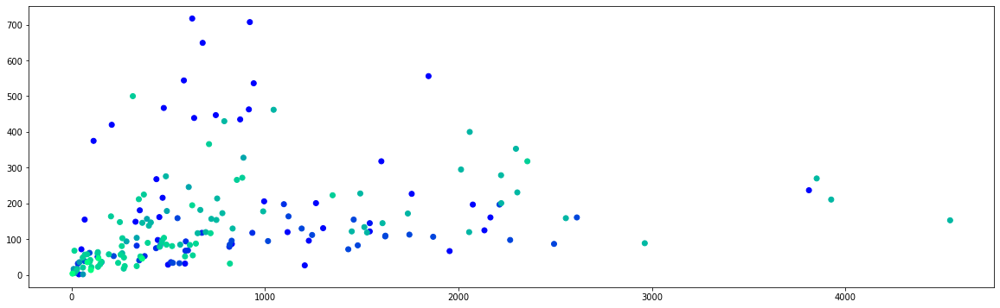

In [ ]:
# scatter plot des données pour essayer de voir si des clusters se forment selon des variables
from scipy.stats import linregress
slope, intercept, r_value, p_value, std_err = linregress(zips['count_restaurants'], zips['count_rats'])
fitLine = slope * zips['count_restaurants'] + intercept
fig, ax = plt.subplots(1, 1, figsize=(20,6))
#ax.plot(zips['count_restaurants'], fitLine, c='b')
ax.scatter(zips['count_rats'], zips['count_restaurants'], c = list(zips['zipcode']), cmap = 'winter')
#On peut voir que l'on peut tirer une corrélation de ses données, même si un certain nombre de valeurs sont aberrantes. Voyons donc plutôt 
###Carte cassée au dernier merg 

On peut voir que l'on peut tirer une corrélation de ses données, même si un certain nombre de valeurs sont aberrantes. Voyons donc plutôt comment évaluer les corrélations entre les colonnes


In [ ]:
import plotly.express as px
fig = px.scatter_matrix(zips, dimensions=["count_rats","count_restaurants","population"])
fig

In [ ]:

fig = px.scatter_matrix(zips1, dimensions=["count_rats","count_bins","population"])
fig


On peut voir que les lieux de compost et la présence de rats ne sont absolument par corrélées, ce qui nous pousse à continuer notre étude sur les restaurants plus profondément en retenant les restaurants comme facteur. 
La population est extrêmement corrélée à la présence de rats, mais il est impossible de recommander de diminuer a population d'un lieu, cependant il est intéressant de garder la population et de l'utiliser pour normaliser la présence de rats : si pour un même nombre d'habitants, deux zipcodes ont une présence de rats significativement différente, c'est qu'il existe un facteur supplémentaire qui explique cette différence ! 

In [ ]:
zips4.corr()

,zipcode,count_rats,population,ratsperH,count_restaurants,Number_tree,count_bin2,count_park,groupe_rat
zipcode,1.000000,-0.141731,0.111856,-0.308848,-0.275592,0.251570,-0.391975,-0.010109,-0.233083
count_rats,-0.141731,1.000000,0.614963,0.713815,0.257488,0.119209,0.377079,0.548395,0.639373
population,0.111856,0.614963,1.000000,0.085186,0.268146,0.466058,0.160322,0.523396,0.635244
ratsperH,-0.308848,0.713815,0.085186,1.000000,0.221197,-0.172724,0.411289,0.285198,0.477812
count_restaurants,-0.275592,0.257488,0.268146,0.221197,1.000000,-0.062104,0.367809,0.199552,0.402257
Number_tree,0.251570,0.119209,0.466058,-0.172724,-0.062104,1.000000,-0.185093,0.279315,0.264897
count_bin2,-0.391975,0.377079,0.160322,0.411289,0.367809,-0.185093,1.000000,0.362374,0.348814
count_park,-0.010109,0.548395,0.523396,0.285198,0.199552,0.279315,0.362374,1.000000,0.490309
groupe_rat,-0.233083,0.639373,0.635244,0.477812,0.402257,0.264897,0.348814,0.490309,1.000000


# Benchmark classifier

## Random forest


In [ ]:
zips2 = zips4.reindex(columns=['count_rats','ratsperH','Number_tree', 'population','count_park','count_restaurants','count_bin2','zipcode','groupe_rat'])
zips2.head()

,count_rats,ratsperH,Number_tree,population,count_park,count_restaurants,count_bin2,zipcode,groupe_rat
0,580,0.025301,911,22924.0,5,544,3,10001,2
1,1845,0.024602,2265,74993.0,28,556,8,10002,2
2,921,0.016843,2025,54682.0,12,707,7,10003,2
3,67,0.022127,118,3028.0,2,155,4,10004,0
4,50,0.005662,144,8831.0,1,72,0,10005,0


In [ ]:
labels=zips2['groupe_rat']
features = zips2.iloc[:,3:8]
X=features

y=np.ravel(labels)


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.34, random_state=42)


In [ ]:
features

,population,count_park,count_restaurants,count_bin2,zipcode
0,22924.0,5,544,3,10001
1,74993.0,28,556,8,10002
2,54682.0,12,707,7,10003
3,3028.0,2,155,4,10004
4,8831.0,1,72,0,10005
...,...,...,...,...,...
174,67094.0,18,46,1,11691
175,20991.0,9,14,1,11692
176,12919.0,9,36,0,11693
177,21354.0,12,47,0,11694


In [ ]:
clf = tree.DecisionTreeClassifier()
clf = clf.fit(X_train, y_train)
pred_y=clf.predict(X_test)
clf.score(X_test,y_test) 

0.6065573770491803

In [ ]:
final_mae = mean_absolute_error(y_test, pred_y)
final_mae

0.4262295081967213

In [ ]:
diff = sklearn.metrics.r2_score(y_test, pred_y, sample_weight=None, multioutput='uniform_average')
diff

0.10388247639034631

## SVM

In [ ]:
from sklearn import svm

In [ ]:
clf1_3 = svm.SVC(kernel='rbf', gamma='auto', cache_size= 7000)
clf1_3.fit(X_train,y_train)

clf1_3.score(X_test,y_test)

0.639344262295082

## Decision tree classifier (labels)

In [ ]:
from sklearn.tree import DecisionTreeClassifier

In [ ]:
clfdt = DecisionTreeClassifier()
clfdt.fit(X_train, y_train)

clfdt.score(X_test, y_test)

0.6065573770491803

## Gradient boosting classifier

In [ ]:

from sklearn import ensemble
GBC = ensemble.GradientBoostingClassifier()

GBC.fit(X_train, y_train)
GBC.score(X_test,y_test)

0.6557377049180327

In [ ]:
print ("Le decision tree obtient un score de ",round(clf.score(X_test,y_test),2) )
print("Le SVM obitent un score de",round(clf1_3.score(X_test,y_test),2))
print("Le gradient Boosting Classifier obtient un scor de ",round(GBC.score(X_test,y_test),2))

Le decision tree obtient un score de  0.61
Le SVM obitent un score de 0.64
Le gradient Boosting Classifier obtient un scor de  0.66


Ainsi, le Gradient boosting classifier semble être la meilleure solution à notre problème

In [ ]:
pred_y = GBC.predict(X_test)

In [ ]:
from sklearn.metrics import roc_auc_score

In [ ]:
pred_y.size

61

In [ ]:
y_test.size

61

In [ ]:
import numpy as np
from sklearn.metrics import roc_auc_score
y_true = np.array([0, 0, 1, 1])
y_scores = np.array([0.1, 0.4, 0.35, 0.8])
roc_auc_score(y_true, y_scores)

0.75

In [ ]:
y_true

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 1, 2, 1, 0, 2, 1, 2,
       2, 1, 0, 1, 0, 1, 2, 2, 2, 0, 2, 1, 2, 1, 1, 2, 2, 1, 0, 2, 2, 2,
       0, 2, 2, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 1, 2, 2, 2])

In [ ]:
ytrue = np.array ([2,2,2,2,2,2,2,2,2,2,2,0,2,0,2,1,2,1,0,2,1,2,2,1,0,1,0,1,2,2,2,0,2,1,2,2,1,0,2,2,2,0,2,2,1,2,2,1,2,2,2,1,1,2,2,2,2,1,2,2,2])

In [ ]:
ytrue

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 1, 2, 1, 0, 2, 1, 2,
       2, 1, 0, 1, 0, 1, 2, 2, 2, 0, 2, 1, 2, 2, 1, 0, 2, 2, 2, 0, 2, 2,
       1, 2, 2, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 1, 2, 2, 2])

In [ ]:
ytrue.size

61

In [ ]:
yscores = np.array([2,2,2,2,2,2,2,1,2,1,1,1,1,0,2,1,2,1,1,2,0,1,2,1,0,2,1,2,2,2,2,0,2,1,1,2,2,2,1,1,1,2,1,2,2,2,2,2,2,2,2,1,2,1,1,2,2,2])

In [ ]:
import numpy as np
from sklearn.metrics import roc_auc_score

roc_auc_score(ytrue, yscores)

ValueError: ignored

# Benchmark regressor (nombre de rats)

In [ ]:
labels2=zips2['count_rats']
features2 = zips2.iloc[:,2:7]
X=features2

y=np.ravel(labels2)


X_trainr, X_testr, y_trainr, y_testr = train_test_split(X, y, test_size=0.34, random_state=42)

In [ ]:
features2

,Number_tree,population,count_park,count_restaurants,count_bin2
0,911,22924.0,5,544,3
1,2265,74993.0,28,556,8
2,2025,54682.0,12,707,7
3,118,3028.0,2,155,4
4,144,8831.0,1,72,0
...,...,...,...,...,...
174,5718,67094.0,18,46,1
175,2013,20991.0,9,14,1
176,1169,12919.0,9,36,0
177,3572,21354.0,12,47,0


## Decision tree regressor 

In [ ]:
from sklearn.tree import DecisionTreeRegressor

In [ ]:
clf1r = DecisionTreeRegressor(max_depth= 2)

In [ ]:
clf1r.fit(X_trainr,y_trainr)
pred_yr=clf1r.predict(X_testr)
clf1r.score(X_testr,y_testr) 

0.12224005916970215

In [ ]:
final_mae = mean_absolute_error(y_testr, pred_yr)
final_mae

541.8167970284653

In [ ]:
p

## GBR 

In [ ]:
from sklearn import ensemble
regGB = ensemble.GradientBoostingRegressor()
regGB.fit(X_trainr, y_trainr)

GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                          init=None, learning_rate=0.1, loss='ls', max_depth=3,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=100,
                          n_iter_no_change=None, presort='deprecated',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False)

In [ ]:
regGB.score(X_testr, y_testr)

0.24937411309216448

In [ ]:
pred_yg = regGB.predict(X_testr)

In [ ]:
tent_mae = mean_absolute_error(y_testr, pred_yg)
tent_mae

437.9642578728097

# Transformation ZIPCODES ramassage déchet fréquence

In [ ]:
freq = pd.read_csv("/content/freq_ramassage_2.csv",sep=";")

freq

,garbage,Neighbourhood,COMMUNITYDISTRICT
0,3,Brooklyn,1
1,3,Brooklyn,2
2,3,Brooklyn,3
3,3,Brooklyn,4
4,2,Brooklyn,5
5,3,Brooklyn,6
6,3,Brooklyn,7
7,3,Brooklyn,8
8,3,Brooklyn,9
9,2,Brooklyn,10


On veut transformer les districts en ZIPCODE (le ramassage des déchets s'effectue à la même fréquence dans un même district)

In [ ]:
bin_array[1][2]

726.0

In [ ]:
real_bin_array =[]
bin_array=freq.to_numpy()
for i in range(len(bin_array)):
    if bin_array[i][1]=='Brooklyn':
      if bin_array[i][2]==1:
        bin_array[i][2] = 11211
        
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11206])
       
       
      
      elif bin_array[i][2]==7:
        bin_array[i][2] = 11220
        
        real_bin_array.append(bin_array[i])
        
      elif bin_array[i][2]==2:
        bin_array[i][2] = 11201
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11217])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11205])
        
      elif bin_array[i][2]==3:
        bin_array[i][2] = 11225
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11238])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11216])
        
        real_bin_array.append(bin_array[i])
      elif bin_array[i][2]==4:
        bin_array[i][2] = 11221
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11233])
        
      elif bin_array[i][2]==5:
        bin_array[i][2] = 11212
       
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11236])
        
      elif bin_array[i][2]==6:
        bin_array[i][2] = 11231
       
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11215])
         
      elif bin_array[i][2]==8:
        bin_array[i][2] = 11226
        real_bin_array.append(bin_array[i])
      elif bin_array[i][2]==9:
        bin_array[i][2] = 11218
        real_bin_array.append(bin_array[i]) 
      elif bin_array[i][2]==10:
        bin_array[i][2] = 11209
       
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11228])
         
      elif bin_array[i][2]==11:
        bin_array[i][2] = 11214
        real_bin_array.append(bin_array[i])
      elif bin_array[i][2]==12:
        bin_array[i][2] = 11204
       
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11219])
         
      elif bin_array[i][2]==13:
        bin_array[i][2] = 11224
        real_bin_array.append(bin_array[i])
      elif bin_array[i][2]==14:
        bin_array[i][2] = 11230
      
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11218])
        
      elif bin_array[i][2]==15:
        bin_array[i][2] = 11229
       
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11229])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11223])
         
      elif bin_array[i][2]==16:
        bin_array[i][2] = 11203
       
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11213])
        
      elif bin_array[i][2]==17:
        bin_array[i][2] = 11210
        real_bin_array.append(bin_array[i]) 
      elif bin_array[i][2]==18:
        bin_array[i][2] = 11234
        real_bin_array.append(bin_array[i])
    elif bin_array[i][1]== 'Manhattan':
      if bin_array[i][2]==1:
        bin_array[i][2] = 10280
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10006])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10004])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10005])
        
      elif bin_array[i][2]==2:
        bin_array[i][2] = 10007
       
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10013])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10012])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10014])
        
      elif bin_array[i][2]==3:
        bin_array[i][2] = 10002
       
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10003])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10038])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10009])
        
      elif bin_array[i][2]==4:
        bin_array[i][2] = 10011
       
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10001])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10018])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10036])
        
        
      elif bin_array[i][2]==5:
        bin_array[i][2] = 10020
       
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10019])
         
      elif bin_array[i][2]==6:
        bin_array[i][2] = 10010
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10016])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10017])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10022])
        
      elif bin_array[i][2]==7:
        bin_array[i][2] = 10023
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10024])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10025])
        
      elif bin_array[i][2]==8:
        bin_array[i][2] = 10044
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10021])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10028])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10128])
        
      elif bin_array[i][2]==9:
        bin_array[i][2] = 10031
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10027])
        
      elif bin_array[i][2]==10:
        bin_array[i][2] = 10026
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10037])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10030])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10039])
        
      elif bin_array[i][2]==11:
        bin_array[i][2] = 10029
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10035])
        
      elif bin_array[i][2]==12:
        bin_array[i][2] = 10032
       
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10033])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10040])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10034])
        
    elif bin_array[i][1]== 'Bronx':
      if bin_array[i][2]==1:
        bin_array[i][2] = 10454
       
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10455])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10451])
        
      if bin_array[i][2]==2:
        bin_array[i][2] = 10474
       
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10459])
        
      elif bin_array[i][2]==3:
        bin_array[i][2] = 10456
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10460])
        
      elif bin_array[i][2]==4:
        bin_array[i][2] = 10452
        real_bin_array.append(bin_array[i]) 
      elif bin_array[i][2]==5:
        bin_array[i][2] = 10453
        real_bin_array.append(bin_array[i]) 
      elif bin_array[i][2]==6:
        bin_array[i][2] = 10457
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10458])
  
      elif bin_array[i][2]==7:
        bin_array[i][2] = 10468
        real_bin_array.append(bin_array[i])
      elif bin_array[i][2]==8:
        bin_array[i][2] = 10463
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10471])

      elif bin_array[i][2]==9:
        bin_array[i][2] = 10472
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10473])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10462])
   
      elif bin_array[i][2]==10:
        bin_array[i][2] = 10465
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10475])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10464])
      elif bin_array[i][2]==11:
        bin_array[i][2] = 10461
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10469])
      elif bin_array[i][2]==12:
        bin_array[i][2] = 10466
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10470])
    elif bin_array[i][1]=='Staten Island':

      if bin_array[i][2]==1:
        bin_array[i][2] = 10303
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10302])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10310])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10301])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10304])
    
      elif bin_array[i][2]==2:
        bin_array[i][2] = 10314
        
        real_bin_array.append(bin_array[i]) 

        real_bin_array.append([bin_array[i][0],bin_array[i][1],10305])
      elif bin_array[i][2]==3:
        bin_array[i][2] = 10309
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10312])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10308])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],10306])
   
    elif bin_array[i][1]=='Queens':
      
      if bin_array[i][2]==1:
        bin_array[i][2] = 11106
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11102])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11105])
    
      elif bin_array[i][2]==2:
        bin_array[i][2] = 11378
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11101])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11104])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11377])
     
      elif bin_array[i][2]==3:
        bin_array[i][2] = 11369
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11370])
    
      elif bin_array[i][2]==4:
        bin_array[i][2] = 11368
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11372])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11373])

      elif bin_array[i][2]==5:
        bin_array[i][2] = 11385
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11379])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11374])
      elif bin_array[i][2]==6:
        bin_array[i][2] = 11375
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11374])
      elif bin_array[i][2]==7:
        bin_array[i][2] = 11360
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11359])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11357])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11356])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11354])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11358])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11355])
        
      elif bin_array[i][2]==8:
        bin_array[i][2] = 11432
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11423])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11427])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11367])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11366])
      
      elif bin_array[i][2]==9:
        bin_array[i][2] = 11416
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11421])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11418])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11419])
      elif bin_array[i][2]==10:
        bin_array[i][2] = 11414
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11417])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11420])
      elif bin_array[i][2]==11:
        bin_array[i][2] = 11364
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11362])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11363])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11361])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11365])
      
      elif bin_array[i][2]==12:
        bin_array[i][2] = 11436
        
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11434])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11433])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11412])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11435])

      elif bin_array[i][2]==13:
        bin_array[i][2] = 11422
        real_bin_array.append(bin_array[i])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11413])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11411])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11429])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11428])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11427])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11426])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11001])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11005])
     
      elif bin_array[i][2]==14:
        bin_array[i][2] = 11697
        real_bin_array.append(bin_array[i])
      
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11694])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11693])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11692])
        real_bin_array.append([bin_array[i][0],bin_array[i][1],11691])
     

In [ ]:
freq.rename(columns={'COMMUNITYDISTRICT':'ZIPCODE'},inplace=True)
freq2 = pd.DataFrame(real_bin_array, columns= freq.columns)
freq3 = freq2.rename(columns={'ZIPCODE': 'zipcode'})

In [ ]:
freq3

,garbage,Neighbourhood,zipcode
0,3,Brooklyn,11211
1,3,Brooklyn,11206
2,3,Brooklyn,11201
3,3,Brooklyn,11217
4,3,Brooklyn,11205
...,...,...,...
164,2,Bronx,10464
165,2,Bronx,10461
166,2,Bronx,10469
167,2,Bronx,10466


In [ ]:
zips4['zipcode']=zips4['zipcode'].astype(int)
freq3['zipcode']=freq3['zipcode'].astype(int)
zips5 = zips4.merge(freq3)

In [ ]:
zips5

,zipcode,count_rats,population,ratsperH,count_restaurants,Number_tree,count_bin2,count_park,groupe_rat,garbage,Neighbourhood
0,10001,580,22924.0,0.025301,544,911,3,5,2,3,Manhattan
1,10002,1845,74993.0,0.024602,556,2265,8,28,2,3,Manhattan
2,10003,921,54682.0,0.016843,707,2025,7,12,2,3,Manhattan
3,10004,67,3028.0,0.022127,155,118,4,2,0,3,Manhattan
4,10005,50,8831.0,0.005662,72,144,0,1,0,3,Manhattan
...,...,...,...,...,...,...,...,...,...,...,...
160,11691,364,67094.0,0.005425,46,5718,1,18,1,2,Queens
161,11692,99,20991.0,0.004716,14,2013,1,9,0,2,Queens
162,11693,81,12919.0,0.006270,36,1169,0,9,0,2,Queens
163,11694,138,21354.0,0.006462,47,3572,0,12,1,2,Queens


In [ ]:
matteo = zips5.reindex(columns=['count_rats','ratsperH','Number_tree', 'population','count_park','count_restaurants','count_bin2','garbage','zipcode','groupe_rat','Neighbourhood'])
matteo

,count_rats,ratsperH,Number_tree,population,count_park,count_restaurants,count_bin2,garbage,zipcode,groupe_rat,Neighbourhood
0,580,0.025301,911,22924.0,5,544,3,3,10001,2,Manhattan
1,1845,0.024602,2265,74993.0,28,556,8,3,10002,2,Manhattan
2,921,0.016843,2025,54682.0,12,707,7,3,10003,2,Manhattan
3,67,0.022127,118,3028.0,2,155,4,3,10004,0,Manhattan
4,50,0.005662,144,8831.0,1,72,0,3,10005,0,Manhattan
...,...,...,...,...,...,...,...,...,...,...,...
160,364,0.005425,5718,67094.0,18,46,1,2,11691,1,Queens
161,99,0.004716,2013,20991.0,9,14,1,2,11692,0,Queens
162,81,0.006270,1169,12919.0,9,36,0,2,11693,0,Queens
163,138,0.006462,3572,21354.0,12,47,0,2,11694,1,Queens


## Classifier

In [ ]:
labelsnew=matteo['groupe_rat']
featuresnew = matteo.iloc[:,2:8]
X=featuresnew

y=np.ravel(labelsnew)


X_train2, X_test2, y_train2, y_test2 = train_test_split(X, y, test_size=0.34, random_state=42)

In [ ]:
featuresnew

,Number_tree,population,count_park,count_restaurants,count_bin2,garbage
0,911,22924.0,5,544,3,3
1,2265,74993.0,28,556,8,3
2,2025,54682.0,12,707,7,3
3,118,3028.0,2,155,4,3
4,144,8831.0,1,72,0,3
...,...,...,...,...,...,...
160,5718,67094.0,18,46,1,2
161,2013,20991.0,9,14,1,2
162,1169,12919.0,9,36,0,2
163,3572,21354.0,12,47,0,2


### SVM

In [ ]:
clf1_3 = svm.SVC(kernel='rbf', gamma='auto', cache_size= 7000)
clf1_3.fit(X_train2,y_train2)

clf1_3.score(X_test2,y_test2)

0.6666666666666666

### DTC

In [ ]:
clf = tree.DecisionTreeClassifier()
clf = clf.fit(X_train2, y_train2)
clf.score(X_test2,y_test2) 

0.6842105263157895

### GBC

In [ ]:
GBCg = ensemble.GradientBoostingClassifier()

GBCg.fit(X_train2, y_train2)
GBCg.score(X_test2,y_test2)

0.7192982456140351

Encore le gradient boosting classifer le meilleur --> progression de la prédiction par rapport à avant

In [ ]:
print ("Le decision tree obtient un score de ",round(clf.score(X_test2,y_test2),2) )
print("Le SVM obitent un score de",round(clf1_3.score(X_test2,y_test2),2))
print("Le gradient Boosting Classifier obtient un scor de ",round(GBCg.score(X_test2,y_test2),2))

Le decision tree obtient un score de  0.68
Le SVM obitent un score de 0.67
Le gradient Boosting Classifier obtient un scor de  0.72


# Action sur ratsperH

In [ ]:
matteo

,count_rats,ratsperH,Number_tree,population,count_park,count_restaurants,count_bin2,garbage,zipcode,groupe_rat,Neighbourhood
0,580,0.025301,911,22924.0,5,544,3,3,10001,2,Manhattan
1,1845,0.024602,2265,74993.0,28,556,8,3,10002,2,Manhattan
2,921,0.016843,2025,54682.0,12,707,7,3,10003,2,Manhattan
3,67,0.022127,118,3028.0,2,155,4,3,10004,0,Manhattan
4,50,0.005662,144,8831.0,1,72,0,3,10005,0,Manhattan
...,...,...,...,...,...,...,...,...,...,...,...
160,364,0.005425,5718,67094.0,18,46,1,2,11691,1,Queens
161,99,0.004716,2013,20991.0,9,14,1,2,11692,0,Queens
162,81,0.006270,1169,12919.0,9,36,0,2,11693,0,Queens
163,138,0.006462,3572,21354.0,12,47,0,2,11694,1,Queens


In [ ]:
matteo.describe()

,count_rats,ratsperH,Number_tree,population,count_park,count_restaurants,count_bin2,garbage,zipcode,groupe_rat
count,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000
mean,870.103030,0.017283,3925.381818,48979.478788,10.787879,157.078788,1.315152,2.412121,10826.612121,1.484848
std,817.294799,0.012492,2888.515142,25568.675779,8.895592,142.607939,2.129371,0.493715,581.040820,0.658954
min,4.000000,0.001130,30.000000,3028.000000,0.000000,2.000000,0.000000,2.000000,10001.000000,0.000000
25%,336.000000,0.008131,2025.000000,29219.000000,5.000000,61.000000,0.000000,2.000000,10303.000000,1.000000
50%,611.000000,0.013949,3391.000000,44205.000000,9.000000,113.000000,0.000000,2.000000,11204.000000,2.000000
75%,1205.000000,0.023562,4893.000000,67809.000000,12.000000,197.000000,2.000000,3.000000,11365.000000,2.000000
max,4542.000000,0.070627,22186.000000,112425.000000,49.000000,717.000000,14.000000,3.000000,11697.000000,2.000000


## Création groupe_perH

In [ ]:
matteo['groupe_perH']= np.where(matteo['ratsperH'] <=0.0095, 0,np.where( (matteo['ratsperH'] >=0.00951 )& (matteo['ratsperH'] <=0.021),1,2))
matteo

,count_rats,ratsperH,Number_tree,population,count_park,count_restaurants,count_bin2,garbage,zipcode,groupe_rat,Neighbourhood,groupe_perH
0,580,0.025301,911,22924.0,5,544,3,3,10001,2,Manhattan,2
1,1845,0.024602,2265,74993.0,28,556,8,3,10002,2,Manhattan,2
2,921,0.016843,2025,54682.0,12,707,7,3,10003,2,Manhattan,1
3,67,0.022127,118,3028.0,2,155,4,3,10004,0,Manhattan,2
4,50,0.005662,144,8831.0,1,72,0,3,10005,0,Manhattan,0
...,...,...,...,...,...,...,...,...,...,...,...,...
160,364,0.005425,5718,67094.0,18,46,1,2,11691,1,Queens,0
161,99,0.004716,2013,20991.0,9,14,1,2,11692,0,Queens,0
162,81,0.006270,1169,12919.0,9,36,0,2,11693,0,Queens,0
163,138,0.006462,3572,21354.0,12,47,0,2,11694,1,Queens,0


In [ ]:
matteo.groupby(['groupe_perH']).describe()

count_rats                                 ... groupe_rat               
                 count         mean         std   min  ...        25%  50%  75%  max
groupe_perH                                            ...                          
0                 52.0   305.096154  252.379442   4.0  ...       0.75  1.0  1.0  2.0
1                 58.0   694.603448  373.498441  67.0  ...       1.00  2.0  2.0  2.0
2                 55.0  1589.363636  976.645835  67.0  ...       2.00  2.0  2.0  2.0

[3 rows x 80 columns]

On a une répartitoon des zipcodes relativement homogène par rapport au nombre totale

## Classifier groupe de rats par habitant

In [ ]:
perH = matteo.reindex(columns=['count_rats','population','ratsperH','Number_tree','count_park','count_restaurants','count_bin2','garbage','groupe_perH','zipcode','groupe_rat'])
perH

,count_rats,population,ratsperH,Number_tree,count_park,count_restaurants,count_bin2,garbage,groupe_perH,zipcode,groupe_rat
0,580,22924.0,0.025301,911,5,544,3,3,2,10001,2
1,1845,74993.0,0.024602,2265,28,556,8,3,2,10002,2
2,921,54682.0,0.016843,2025,12,707,7,3,1,10003,2
3,67,3028.0,0.022127,118,2,155,4,3,2,10004,0
4,50,8831.0,0.005662,144,1,72,0,3,0,10005,0
...,...,...,...,...,...,...,...,...,...,...,...
160,364,67094.0,0.005425,5718,18,46,1,2,0,11691,1
161,99,20991.0,0.004716,2013,9,14,1,2,0,11692,0
162,81,12919.0,0.006270,1169,9,36,0,2,0,11693,0
163,138,21354.0,0.006462,3572,12,47,0,2,0,11694,1


In [ ]:
groupe=perH['groupe_perH']
donnees = perH.iloc[:,3:8]
X=donnees

y=np.ravel(groupe)


X_trainH, X_testH, y_trainH, y_testH = train_test_split(X, y, test_size=0.34, random_state=42)

In [ ]:
donnees

,Number_tree,count_park,count_restaurants,count_bin2,garbage
0,911,5,544,3,3
1,2265,28,556,8,3
2,2025,12,707,7,3
3,118,2,155,4,3
4,144,1,72,0,3
...,...,...,...,...,...
160,5718,18,46,1,2
161,2013,9,14,1,2
162,1169,9,36,0,2
163,3572,12,47,0,2


### GBC

In [ ]:
GBCH = ensemble.GradientBoostingClassifier()

GBCH.fit(X_trainH, y_trainH)
GBCH.score(X_testH,y_testH)

0.6491228070175439

On a un score légèrement plus bas, ce qui est normal car on enlève la donnée la plus corrélée avec la présence de rats, qui est la population. Le score reste quand même acceptable par rapport au score précedent

### SVM

In [ ]:
SVMH = svm.SVC(kernel='rbf', gamma='auto', cache_size= 7000)
SVMH.fit(X_trainH,y_trainH)

SVMH.score(X_testH,y_testH)

0.24561403508771928

# Tentative prédiction

In [ ]:
aurele = perH

In [ ]:
aurele.loc[aurele["garbage"] == 2,"garbage"] = 3


In [ ]:
Xtentpred  = aurele.iloc[:,3:8]

In [ ]:
Xtentpred

,Number_tree,count_park,count_restaurants,count_bin2,garbage
0,911,5,544,3,3
1,2265,28,556,8,3
2,2025,12,707,7,3
3,118,2,155,4,3
4,144,1,72,0,3
...,...,...,...,...,...
160,5718,18,46,1,3
161,2013,9,14,1,3
162,1169,9,36,0,3
163,3572,12,47,0,3


In [ ]:
pred_perh = GBCH.predict(Xtentpred)

In [ ]:
pred_perh

array([2, 2, 2, 2, 0, 2, 2, 2, 1, 2, 2, 2, 2, 1, 0, 2, 1, 1, 1, 2, 2, 2,
       2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1, 1, 2, 0, 1, 2, 1, 0, 1,
       1, 0, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 1, 1, 1, 1, 1, 1,
       2, 1, 2, 1, 2, 0, 2, 0, 0, 2, 2, 2, 1, 2, 1, 1, 1, 2, 2, 0, 1, 1,
       1, 2, 0, 2, 2, 2, 1, 1, 0, 2, 1, 0, 1, 2, 2, 2, 0, 0, 0, 0, 1, 2,
       0, 0, 2, 0, 0, 2, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 1, 2, 2,
       2, 2, 1, 1, 1, 2, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       2, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0])

In [ ]:
a = np.sum(pred_perh ==0)
b = np.sum(pred_perh ==1)
c = np.sum(pred_perh ==2)
print ('il y a ',a,'classes 0, contre 52 avant ')
print ('il y a ',b,'classes 1 contre 58 avant')
print ('il y a ',c,'classes 2 contre 55 avant')

il y a  48 classes 0, contre 52 avant 
il y a  52 classes 1 contre 58 avant
il y a  65 classes 2 contre 55 avant


On remarque qu'il y a plus de rats, alors que nous voulions le contraire. On se dit que plus il y a de ramassage, plus il y a de personnes donc nous allons créé une nouvelle variable qui est le nombre de ramassage par habitant 

## Création de garbage/habitant

In [ ]:
for i in range(165) :   
 if matteo.count_bin2[i] == 0 : 
   matteo["freqpercount"][i] = 0
 else : 

  matteo["freqpercount"][i]=matteo["garbage"][i]/matteo["count_bin2"][i]

KeyError: ignored

In [ ]:
matteo

,count_rats,ratsperH,Number_tree,population,count_park,count_restaurants,count_bin2,garbage,zipcode,groupe_rat,Neighbourhood,groupe_perH
0,1622,0.021320,3320,76078.0,30,110,2,3,10452,2,Bronx,2
1,1869,0.023478,3050,79606.0,23,107,0,3,10453,2,Bronx,2
2,1746,0.022200,2990,78647.0,13,113,4,3,10468,2,Bronx,2
3,561,0.008368,5452,67040.0,5,85,0,3,11210,2,Brooklyn,0
4,752,0.008091,4341,92946.0,10,214,0,2,11214,2,Brooklyn,0
5,722,0.009690,4868,74508.0,12,157,1,3,11218,2,Brooklyn,1
6,789,0.008249,4677,95643.0,11,430,3,3,11220,2,Brooklyn,0
7,467,0.009999,1949,46707.0,18,97,0,3,11224,1,Brooklyn,1
8,1607,0.027292,2868,58882.0,8,145,0,3,11225,2,Brooklyn,2
9,1607,0.027292,2868,58882.0,8,145,0,3,11225,2,Brooklyn,2


In [ ]:
matteo.groupby(['groupe_perH']).describe()

KeyError: ignored

Donc les résulats ne sont pas satisfaisants. Malgré le rationnement par la population, il semblerait qu'il n'y ait pas de corrélation entre la fréquence de ramassage de déchêts et le nombre de rats. Il doit y avoir une variable externe relaiant ces deux variables mais nous ne l'avons pas trouvé. 
Dans le cas où il y avait une corrélation directe entre la fréquence des ramassages, nous aurions aimé voir la quantité de zicodes changeant de classes, et le coût pour la ville de New York de mettre en plce de système (n mployés en plus, n camions, ...)

## freqbyzip

In [ ]:
bin_array[3][2]

11221

In [ ]:
real_bin_array =[]
bin_array=freq.to_numpy()
for i in range(len(bin_array)):
    if bin_array[i][1]=='Brooklyn':
      if bin_array[i][2]==1:
        bin_array[i][2] = 11211
        
        #print(bin_array[i])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],11206])
        print(real_bin_array)
       
        
        
        #print(bin_array[i])
        
      elif bin_array[i][2]==7:
        bin_array[i][2] = 11220
        
        real_bin_array.append(bin_array[i])
        
      elif bin_array[i][2]==2:
        bin_array[i][2] = 11201
        
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],11217])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],11205])
        
      elif bin_array[i][2]==3:
        bin_array[i][2] = 11225
        
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],11238])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],11216])
        
        real_bin_array.append(bin_array[i])
      elif bin_array[i][2]==4:
        bin_array[i][2] = 11221
        
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],11233])
        
      elif bin_array[i][2]==5:
        bin_array[i][2] = 11212
       
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],11236])
        
      elif bin_array[i][2]==6:
        bin_array[i][2] = 11231
       
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],11215])
         
      elif bin_array[i][2]==8:
        bin_array[i][2] = 11226
        real_bin_array.append(bin_array[i])
      elif bin_array[i][2]==9:
        bin_array[i][2] = 11218
        real_bin_array.append(bin_array[i]) 
      elif bin_array[i][2]==10:
        bin_array[i][2] = 11209
       
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],11228])
         
      elif bin_array[i][2]==11:
        bin_array[i][2] = 11214
        real_bin_array.append(bin_array[i])
      elif bin_array[i][2]==12:
        bin_array[i][2] = 11204
       
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],11219])
         
      elif bin_array[i][2]==13:
        bin_array[i][2] = 11224
        real_bin_array.append(bin_array[i])
      elif bin_array[i][2]==14:
        bin_array[i][2] = 11230
      
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],11218])
        
      elif bin_array[i][2]==15:
        bin_array[i][2] = 11229
       
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],11229])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],11223])
         
      elif bin_array[i][2]==16:
        bin_array[i][2] = 11203
       
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],11213])
        
      elif bin_array[i][2]==17:
        bin_array[i][2] = 11210
        real_bin_array.append(bin_array[i]) 
      elif bin_array[i][2]==18:
        bin_array[i][2] = 11234
        real_bin_array.append(bin_array[i])
    elif bin_array[i][1]== 'Manhattan':
      if bin_array[i][2]==1:
        bin_array[i][2] = 10280
        
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10006])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10004])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10005])
        
      elif bin_array[i][2]==2:
        bin_array[i][2] = 10007
       
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10013])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10012])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10014])
        
      elif bin_array[i][2]==3:
        bin_array[i][2] = 10002
       
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10003])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10038])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10009])
        
      elif bin_array[i][2]==4:
        bin_array[i][2] = 10011
       
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10001])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10018])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10036])
        
        
      elif bin_array[i][2]==5:
        bin_array[i][2] = 10020
       
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],10019])
         
      elif bin_array[i][2]==6:
        bin_array[i][2] = 10010
        
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10016])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10017])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10022])
        
      elif bin_array[i][2]==7:
        bin_array[i][2] = 10023
        
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],10024])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],10025])
        
      elif bin_array[i][2]==8:
        bin_array[i][2] = 10044
        
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10021])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10028])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10128])
        
      elif bin_array[i][2]==9:
        bin_array[i][2] = 10031
        
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],10027])
        
      elif bin_array[i][2]==10:
        bin_array[i][2] = 10026
        
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10037])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10030])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10039])
        
      elif bin_array[i][2]==11:
        bin_array[i][2] = 10029
        
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],10035])
        
      elif bin_array[i][2]==12:
        bin_array[i][2] = 10032
       
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10033])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10040])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10034])
        
    elif bin_array[i][1]== 'Bronx':
      if bin_array[i][2]==1:
        bin_array[i][2] = 10454
       
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],10455])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],10451])
        
      if bin_array[i][2]==2:
        bin_array[i][2] = 10474
       
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],10459])
        
      elif bin_array[i][2]==3:
        bin_array[i][2] = 10456
        
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],10460])
        
      elif bin_array[i][2]==4:
        bin_array[i][2] = 10452
        real_bin_array.append(bin_array[i]) 
      elif bin_array[i][2]==5:
        bin_array[i][2] = 10453
        real_bin_array.append(bin_array[i]) 
      elif bin_array[i][2]==6:
        bin_array[i][2] = 10457
        
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],10458])
  
      elif bin_array[i][2]==7:
        bin_array[i][2] = 10468
        real_bin_array.append(bin_array[i])
      elif bin_array[i][2]==8:
        bin_array[i][2] = 10463
        
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],10471])

      elif bin_array[i][2]==9:
        bin_array[i][2] = 10472
        
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],10473])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],10462])
   
      elif bin_array[i][2]==10:
        bin_array[i][2] = 10465
        
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],10475])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],10464])
      elif bin_array[i][2]==11:
        bin_array[i][2] = 10461
        
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],10469])
      elif bin_array[i][2]==12:
        bin_array[i][2] = 10466
        
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],10470])
    elif bin_array[i][1]=='Staten Island':
      print("Staten")
      if bin_array[i][2]==1:
        bin_array[i][2] = 10303
        
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],10302])
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],10310])
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],10301])
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],10304])
    
      elif bin_array[i][2]==2:
        bin_array[i][2] = 10314
        
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])

        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],10305])
      elif bin_array[i][2]==3:
        bin_array[i][2] = 10309
        
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10312])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10308])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],10306])
   
    elif bin_array[i][1]=='Queens':
      print("queen")
      if bin_array[i][2]==1:
        bin_array[i][2] = 11106
        
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],11102])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],11105])
    
      elif bin_array[i][2]==2:
        bin_array[i][2] = 11378
        
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],11101])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],11104])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],11377])
     
      elif bin_array[i][2]==3:
        bin_array[i][2] = 11369
        
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],11370])
    
      elif bin_array[i][2]==4:
        bin_array[i][2] = 11368
        
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],11372])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],11373])

      elif bin_array[i][2]==5:
        bin_array[i][2] = 11385
        
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],11379])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],11374])
      elif bin_array[i][2]==6:
        bin_array[i][2] = 11375
        
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/2,bin_array[i][1],11374])
      elif bin_array[i][2]==7:
        bin_array[i][2] = 11360
        
        real_bin_array.append([bin_array[i][0]/7,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/7,bin_array[i][1],11359])
        real_bin_array.append([bin_array[i][0]/7,bin_array[i][1],11357])
        real_bin_array.append([bin_array[i][0]/7,bin_array[i][1],11356])
        real_bin_array.append([bin_array[i][0]/7,bin_array[i][1],11354])
        real_bin_array.append([bin_array[i][0]/7,bin_array[i][1],11358])
        real_bin_array.append([bin_array[i][0]/7,bin_array[i][1],11355])
        
      elif bin_array[i][2]==8:
        bin_array[i][2] = 11432
        
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],11423])
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],11427])
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],11367])
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],11366])
      
      elif bin_array[i][2]==9:
        bin_array[i][2] = 11416
        
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],11421])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],11418])
        real_bin_array.append([bin_array[i][0]/4,bin_array[i][1],11419])
      elif bin_array[i][2]==10:
        bin_array[i][2] = 11414
        
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],11417])
        real_bin_array.append([bin_array[i][0]/3,bin_array[i][1],11420])
      elif bin_array[i][2]==11:
        bin_array[i][2] = 11364
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],11362])
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],11363])
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],11361])
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],11365])
      
      elif bin_array[i][2]==12:
        bin_array[i][2] = 11436
        
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],11434])
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],11433])
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],11412])
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],11435])

      elif bin_array[i][2]==13:
        bin_array[i][2] = 11422
        real_bin_array.append([bin_array[i][0]/9,bin_array[i][1],bin_array[i][2]])
        real_bin_array.append([bin_array[i][0]/9,bin_array[i][1],11413])
        real_bin_array.append([bin_array[i][0]/9,bin_array[i][1],11411])
        real_bin_array.append([bin_array[i][0]/9,bin_array[i][1],11429])
        real_bin_array.append([bin_array[i][0]/9,bin_array[i][1],11428])
        real_bin_array.append([bin_array[i][0]/9,bin_array[i][1],11427])
        real_bin_array.append([bin_array[i][0]/9,bin_array[i][1],11426])
        real_bin_array.append([bin_array[i][0]/9,bin_array[i][1],11001])
        real_bin_array.append([bin_array[i][0]/9,bin_array[i][1],11005])
     
      elif bin_array[i][2]==14:
        bin_array[i][2] = 11697
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],bin_array[i][2]])
      
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],11694])
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],11693])
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],11692])
        real_bin_array.append([bin_array[i][0]/5,bin_array[i][1],11691])

[[1.5, 'Brooklyn', 11211], [1.5, 'Brooklyn', 11206]]
queen
queen
queen
queen
queen
queen
queen
queen
queen
queen
queen
queen
queen
queen
Staten
Staten
Staten


## Skurt

In [ ]:
freq.rename(columns={'COMMUNITYDISTRICT':'ZIPCODE'},inplace=True)
freqa = pd.DataFrame(real_bin_array, columns= freq.columns)
freqb = freqa.rename(columns={'ZIPCODE': 'zipcode'})

In [ ]:
matteo['garbage'].sum()

35

In [ ]:
freqb

,garbage,Neighbourhood,zipcode
0,1.500000,Brooklyn,11211
1,1.500000,Brooklyn,11206
2,1.000000,Brooklyn,11201
3,1.000000,Brooklyn,11217
4,1.000000,Brooklyn,11205
...,...,...,...
164,0.666667,Bronx,10464
165,1.000000,Bronx,10461
166,1.000000,Bronx,10469
167,1.000000,Bronx,10466


In [ ]:
freq['garbage'].sum()

147

In [ ]:
matteo['zipcode']=matteo['zipcode'].astype(int)
freqb['zipcode']=freqb['zipcode'].astype(int)
boisseau = matteo.merge(freqb)

/usr/local/lib/python3.6/dist-packages/pandas/core/reshape/merge.py:1127: UserWarning: You are merging on int and float columns where the float values are not equal to their int representation
  UserWarning,


In [ ]:
matteo

,count_rats,ratsperH,Number_tree,population,count_park,count_restaurants,count_bin2,garbage,zipcode,groupe_rat,Neighbourhood,groupe_perH
0,1622,0.021320,3320,76078.0,30,110,2,3,10452,2,Bronx,2
1,1869,0.023478,3050,79606.0,23,107,0,3,10453,2,Bronx,2
2,1746,0.022200,2990,78647.0,13,113,4,3,10468,2,Bronx,2
3,561,0.008368,5452,67040.0,5,85,0,3,11210,2,Brooklyn,0
4,752,0.008091,4341,92946.0,10,214,0,2,11214,2,Brooklyn,0
5,722,0.009690,4868,74508.0,12,157,1,3,11218,2,Brooklyn,1
6,789,0.008249,4677,95643.0,11,430,3,3,11220,2,Brooklyn,0
7,467,0.009999,1949,46707.0,18,97,0,3,11224,1,Brooklyn,1
8,1607,0.027292,2868,58882.0,8,145,0,3,11225,2,Brooklyn,2
9,1607,0.027292,2868,58882.0,8,145,0,3,11225,2,Brooklyn,2


# Activation2

In [ ]:
matteo.corr()

,count_rats,ratsperH,Number_tree,population,count_park,count_restaurants,count_bin2,garbage,zipcode,groupe_rat,groupe_perH
count_rats,1.000000,0.773532,0.045626,0.569425,0.521902,0.226031,0.364337,0.447037,-0.176849,0.617283,0.636924
ratsperH,0.773532,1.000000,-0.216678,0.074358,0.318598,0.207710,0.452375,0.549272,-0.400247,0.525029,0.820333
Number_tree,0.045626,-0.216678,1.000000,0.419040,0.189516,-0.105673,-0.247012,-0.393918,0.261586,0.181160,-0.225929
population,0.569425,0.074358,0.419040,1.000000,0.468719,0.238776,0.112236,0.064437,0.113339,0.587968,0.075977
count_park,0.521902,0.318598,0.189516,0.468719,1.000000,0.189537,0.341231,0.201902,-0.054376,0.461827,0.323945
count_restaurants,0.226031,0.207710,-0.105673,0.238776,0.189537,1.000000,0.363203,0.438010,-0.307240,0.355820,0.232749
count_bin2,0.364337,0.452375,-0.247012,0.112236,0.341231,0.363203,1.000000,0.415105,-0.429709,0.333689,0.475365
garbage,0.447037,0.549272,-0.393918,0.064437,0.201902,0.438010,0.415105,1.000000,-0.547663,0.337931,0.531674
zipcode,-0.176849,-0.400247,0.261586,0.113339,-0.054376,-0.307240,-0.429709,-0.547663,1.000000,-0.279190,-0.537488
groupe_rat,0.617283,0.525029,0.181160,0.587968,0.461827,0.355820,0.333689,0.337931,-0.279190,1.000000,0.556276


In [ ]:
matteo['count_bin2'].sum()

217

In [ ]:
217/165

1.3151515151515152

In [ ]:
matteo['count_min_avg'] = 1.315 

In [ ]:
matteo

,count_rats,ratsperH,Number_tree,population,count_park,count_restaurants,count_bin2,garbage,zipcode,groupe_rat,Neighbourhood,count_min_avg
0,580,0.025301,911,22924.0,5,544,3,3,10001,2,Manhattan,1.315
1,1845,0.024602,2265,74993.0,28,556,8,3,10002,2,Manhattan,1.315
2,921,0.016843,2025,54682.0,12,707,7,3,10003,2,Manhattan,1.315
3,67,0.022127,118,3028.0,2,155,4,3,10004,0,Manhattan,1.315
4,50,0.005662,144,8831.0,1,72,0,3,10005,0,Manhattan,1.315
...,...,...,...,...,...,...,...,...,...,...,...,...
160,364,0.005425,5718,67094.0,18,46,1,2,11691,1,Queens,1.315
161,99,0.004716,2013,20991.0,9,14,1,2,11692,0,Queens,1.315
162,81,0.006270,1169,12919.0,9,36,0,2,11693,0,Queens,1.315
163,138,0.006462,3572,21354.0,12,47,0,2,11694,1,Queens,1.315


In [ ]:
avgr = matteo.reindex(columns=['count_rats','population','ratsperH','Number_tree','count_park','count_restaurants','count_min_avg','garbage','groupe_perH','zipcode','count_bin2','groupe_rat'])
avgr

,count_rats,population,ratsperH,Number_tree,count_park,count_restaurants,count_min_avg,garbage,groupe_perH,zipcode,count_bin2,groupe_rat
0,580,22924.0,0.025301,911,5,544,1.315,3,NaN,10001,3,2
1,1845,74993.0,0.024602,2265,28,556,1.315,3,NaN,10002,8,2
2,921,54682.0,0.016843,2025,12,707,1.315,3,NaN,10003,7,2
3,67,3028.0,0.022127,118,2,155,1.315,3,NaN,10004,4,0
4,50,8831.0,0.005662,144,1,72,1.315,3,NaN,10005,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
160,364,67094.0,0.005425,5718,18,46,1.315,2,NaN,11691,1,1
161,99,20991.0,0.004716,2013,9,14,1.315,2,NaN,11692,1,0
162,81,12919.0,0.006270,1169,9,36,1.315,2,NaN,11693,0,0
163,138,21354.0,0.006462,3572,12,47,1.315,2,NaN,11694,0,1


In [ ]:
 Gavg = ensemble.GradientBoostingClassifier()

In [ ]:
X_pred_avg  = avgr.iloc[:,3:8]

In [ ]:
X_pred_avg

,Number_tree,count_park,count_restaurants,count_min_avg,garbage
0,911,5,544,1.315,3
1,2265,28,556,1.315,3
2,2025,12,707,1.315,3
3,118,2,155,1.315,3
4,144,1,72,1.315,3
...,...,...,...,...,...
160,5718,18,46,1.315,2
161,2013,9,14,1.315,2
162,1169,9,36,1.315,2
163,3572,12,47,1.315,2


In [ ]:
pred_avg = GBCH.predict(X_pred_avg)

In [ ]:
pred_avg

array([1, 2, 2, 1, 0, 2, 1, 1, 1, 2, 1, 0, 2, 1, 0, 1, 1, 1, 1, 2, 1, 1,
       2, 2, 1, 2, 1, 2, 2, 1, 1, 2, 1, 2, 1, 1, 1, 2, 0, 1, 2, 1, 0, 1,
       1, 0, 1, 0, 1, 1, 2, 2, 2, 2, 2, 1, 0, 2, 2, 2, 0, 1, 1, 1, 1, 1,
       2, 1, 2, 1, 2, 0, 2, 0, 0, 2, 1, 1, 1, 1, 1, 1, 1, 2, 1, 0, 1, 1,
       1, 2, 0, 2, 2, 2, 1, 1, 0, 1, 1, 0, 2, 2, 2, 1, 0, 0, 0, 0, 1, 1,
       0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 2,
       2, 0, 0, 1, 1, 2, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       2, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0])

In [ ]:

a = np.sum(pred_avg ==0)
b = np.sum(pred_avg ==1)
c = np.sum(pred_avg ==2)
print ('il y a ',a,'classes 0, contre 52 avant ')
print ('il y a ',b,'classes 1 contre 58 avant')
print ('il y a ',c,'classes 2 contre 55 avant')

il y a  56 classes 0, contre 52 avant 
il y a  69 classes 1 contre 58 avant
il y a  40 classes 2 contre 55 avant


On remarque donc qu'une équipartition des poubelles dans la ville de New York permet une grande baisse du nombre de rats par habitant. Voyons combien de zipcodes sont passé d'un groupe à l'autre 

In [ ]:
c = 0
for i in range (165) : 
  if matteo['groupe_perH'][i] == pred_avg[i] : 
    c+=1

In [ ]:
c

126

Il y a donc seulement 36 Zipcodes qui changent de classes sur les 165, soit 22% des Zipcodes qui sont impactés par ce changement. 

In [ ]:
no_mouv = 0 
desc1 = 0
desc2 = 0
aa1 = 0
aa2 = 0
aa3 = 0
bb1 = 0
bb2 = 0
bb3 = 0
for i in range (165) : 
  if matteo['groupe_perH'][i] == 2:
    if pred_avg[i] ==2 :
      no_mouv+=1
    if pred_avg[i] == 1 : 
      desc1+=1
    if pred_avg[i] == 0 : 
      desc2 += 1
  if matteo['groupe_perH'][i] == 1:
    if pred_avg[i] ==2 :
      aa1+=1
    if pred_avg[i] == 1 : 
      aa2+=1
    if pred_avg[i] == 0 : 
      aa3 += 1
  if matteo['groupe_perH'][i] == 0:
    if pred_avg[i] ==2 :
      bb1+=1
    if pred_avg[i] == 1 : 
      bb2+=1
    if pred_avg[i] == 0 : 
      bb3 += 1

In [ ]:
print(bb1,aa2,aa3)

0 46 5


In [ ]:
print('Il y a ',no_mouv,'zipcodes qui sont restés dans le groupe le plus haut')
print('Il y a',desc1,'zipcodes qui passent du groupe élevé au groupe moyen')
print('Il y a', desc2,'zipcodes qui passent du groupe élevé au groupe faible')
print('Il y a ',aa2,'zipcodes qui sont restés dans le groupe le moyen')
print('Il y a',aa1,'zipcodes qui passent du groupe moyen au groupe élevé')
print('Il y a', aa3,'zipcodes qui passent du groupe moyen au groupe faible')
print('Il y a ',bb3,'zipcodes qui sont restés dans le groupe le plus faible')
print('Il y a',bb2,'zipcodes qui passent du groupe faible au groupe moyen')
print('Il y a', bb1,'zipcodes qui passent du groupe faible au groupe élevé')

Il y a  33 zipcodes qui sont restés dans le groupe le plus haut
Il y a 18 zipcodes qui passent du groupe élevé au groupe moyen
Il y a 4 zipcodes qui passent du groupe élevé au groupe faible
Il y a  46 zipcodes qui sont restés dans le groupe le moyen
Il y a 7 zipcodes qui passent du groupe moyen au groupe élecé
Il y a 5 zipcodes qui passent du groupe moyen au groupe faible
Il y a  47 zipcodes qui sont restés dans le groupe le plus faible
Il y a 5 zipcodes qui passent du groupe faible au groupe moyen
Il y a 0 zipcodes qui passent du groupe faible au groupe élevé


## Répartition physiquement applicable

In [ ]:
matteo

,count_rats,ratsperH,Number_tree,population,count_park,count_restaurants,count_bin2,garbage,zipcode,groupe_rat,Neighbourhood,groupe_perH
0,580,0.025301,911,22924.0,5,544,3,3,10001,2,Manhattan,2
1,1845,0.024602,2265,74993.0,28,556,8,3,10002,2,Manhattan,2
2,921,0.016843,2025,54682.0,12,707,7,3,10003,2,Manhattan,1
3,67,0.022127,118,3028.0,2,155,4,3,10004,0,Manhattan,2
4,50,0.005662,144,8831.0,1,72,0,3,10005,0,Manhattan,0
...,...,...,...,...,...,...,...,...,...,...,...,...
160,364,0.005425,5718,67094.0,18,46,1,2,11691,1,Queens,0
161,99,0.004716,2013,20991.0,9,14,1,2,11692,0,Queens,0
162,81,0.006270,1169,12919.0,9,36,0,2,11693,0,Queens,0
163,138,0.006462,3572,21354.0,12,47,0,2,11694,1,Queens,0


In [ ]:
aurele = matteo.copy()
binoche = aurele['count_bin2']
binoche.to_numpy()

array([ 3,  8,  7,  4,  0,  0,  2, 14,  0,  6,  2,  2,  4,  0,  1,  5,  2,
        1,  0,  2,  6,  4,  9,  2,  1,  3,  8,  6,  6,  2,  2,  2,  2,  0,
        0,  0,  1,  2,  0,  0,  0,  0,  0,  0,  0,  0,  0,  3,  0,  1,  6,
        2,  0,  2,  0,  4,  0,  3,  1,  5,  0,  0,  1,  0,  0,  1,  4,  0,
        0,  0,  1,  0,  6,  0,  0,  4,  3,  2,  1,  3,  2,  1,  0,  0,  3,
        1,  0,  1,  2,  1,  0,  2,  0,  1,  1,  1,  0,  3,  0,  0,  0,  0,
        0,  2,  0,  0,  0,  0,  3,  3,  0,  1,  4,  0,  1,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  1,  0,  0,  1,  2,  1,  1,  2,  1,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  1,  0,  1,  1,  0,  0,  0])

In [ ]:
for i in range (165) : 
  if (binoche[i] ==0) : 
    binoche[i] = 1
  if (binoche[i]>=2) : 
    binoche[i] = 2

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
binoche

0      2
1      2
2      2
3      2
4      1
      ..
160    1
161    1
162    1
163    1
164    1
Name: count_bin2, Length: 165, dtype: int64

In [ ]:
matteo['binoche'] = binoche

In [ ]:
testr = matteo.reindex(columns=['count_rats','population','ratsperH','Number_tree','count_park','count_restaurants','binoche','garbage','groupe_perH','zipcode','count_bin2','groupe_rat'])
testr

,count_rats,population,ratsperH,Number_tree,count_park,count_restaurants,binoche,garbage,groupe_perH,zipcode,count_bin2,groupe_rat
0,580,22924.0,0.025301,911,5,544,2,3,2,10001,3,2
1,1845,74993.0,0.024602,2265,28,556,2,3,2,10002,8,2
2,921,54682.0,0.016843,2025,12,707,2,3,1,10003,7,2
3,67,3028.0,0.022127,118,2,155,2,3,2,10004,4,0
4,50,8831.0,0.005662,144,1,72,1,3,0,10005,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
160,364,67094.0,0.005425,5718,18,46,1,2,0,11691,1,1
161,99,20991.0,0.004716,2013,9,14,1,2,0,11692,1,0
162,81,12919.0,0.006270,1169,9,36,1,2,0,11693,0,0
163,138,21354.0,0.006462,3572,12,47,1,2,0,11694,0,1


In [ ]:
X_pred_testr  = testr.iloc[:,3:8]

In [ ]:
pred_avg = GBCH.predict(X_pred_avg)
a = np.sum(pred_avg ==0)
b = np.sum(pred_avg ==1)
c = np.sum(pred_avg ==2)
print ('il y a ',a,'classes 0, contre 52 avant ')
print ('il y a ',b,'classes 1 contre 58 avant')
print ('il y a ',c,'classes 2 contre 55 avant')

il y a  56 classes 0, contre 52 avant 
il y a  69 classes 1 contre 58 avant
il y a  40 classes 2 contre 55 avant


In [ ]:
testr['binoche'].sum()

215

## Visualisation changement

In [ ]:
import pandas as pd
import numpy as np
import folium 
from folium import plugins
import json

def generateBaseMap(default_location=[40.693943, -73.985880], default_zoom_start=12):
    base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)
    return base_map

with open("/content/NY.geojson") as f:
    NY = json.load(f)

map=generateBaseMap()

folium.Choropleth(geo_data='/content/NY.geojson', data=matteo, columns=['zipcode', 'groupe_perH'], \
                 key_on='feature.properties.ZIPCODE',fill_color='YlOrRd',bins=3,highlight=True, fill_opacity=1,legend_name="Observations de rats à New York par code postaux").add_to(map)

map.save('/content/NYChoropleth.html')

In [ ]:
map

In [ ]:
matteo['groupe_perH_new'] = pred_avg

In [ ]:

def generateBaseMap(default_location=[40.693943, -73.985880], default_zoom_start=12):
    base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)
    return base_map

with open("/content/NY.geojson") as f:
    NY = json.load(f)

map_new=generateBaseMap()

folium.Choropleth(geo_data='/content/NY.geojson', data=matteo, columns=['zipcode', 'groupe_perH_new'], \
                 key_on='feature.properties.ZIPCODE',fill_color='YlOrRd',bins=3,highlight=True, fill_opacity=1,legend_name="Observations de rats à New York par code postaux").add_to(map_new)



In [ ]:
map_new

In [ ]:
matteo['groupe_perH_new'] = pred_avg

In [ ]:
base2 = [4]*165
base1 = [4]*165
base0 = [4]*165
for i in range (165) : 
  if matteo['groupe_perH'][i] == 2:
    if pred_avg[i] ==2 :
      base2[i] = 0
    if pred_avg[i] == 1 : 
      base2[i] = -1
    if pred_avg[i] == 0 : 
      base2[i] = -2
  if matteo['groupe_perH'][i] == 1:
    if pred_avg[i] ==2 :
      base1[i] = 1
    if pred_avg[i] == 1 : 
      base1[i] = 0
    if pred_avg[i] == 0 : 
      base1[i] = -1
  if matteo['groupe_perH'][i] == 0:
    if pred_avg[i] ==2 :
      base0[i] = 2
    if pred_avg[i] == 1 : 
      base0[i] = 1
    if pred_avg[i] == 0 : 
      base0[i] = 0

In [ ]:
matteo['changement2'] = base2
matteo['changement1'] = base1
matteo['changement0'] = base0

In [ ]:
map2=generateBaseMap()

folium.Choropleth(geo_data='/content/NY.geojson', data=matteo, columns=['zipcode', 'changement0'], \
                 key_on='feature.properties.ZIPCODE',fill_color='YlOrRd',bins=4,highlight=True, fill_opacity=1,legend_name="Observations de rats à New York par code postaux").add_to(map2)
map2


## Réalité

Ce modèle est très efficace théoriquement mais plusieurs facteurs nous empêchent de le mettre en place : 

*   Le premier facteur est un facteur physique : bien évidemment, il est impossible de mettre 1,3 composteur par zipcode car cela n'a aucun sens de diviser une poubelle.
*   Le deuxième est un problème plus relatif : en effet, il faut se demander si lorsqu'il y a 8 points de compost au même endroit, ce n'est pas pour la décoration mais sûrement car il y plus de population. 



Pour appuyer ce deuxième facteur, nous pouvons observer la corrélation entre le nombre de poubelles et la population : 

In [ ]:
Corre_bin_pop=pd.DataFrame()

Corre_bin_pop["population"]=matteo['population']
Corre_bin_pop["composteur"]=matteo['count_bin2']
Corre_bin_pop["restaurants"] = matteo['count_restaurants']

In [ ]:
Corre_bin_pop.corr()

,population,composteur,restaurants
population,1.000000,0.112236,0.238776
composteur,0.112236,1.000000,0.363203
restaurants,0.238776,0.363203,1.000000


On se rend compte que la corrélation est assez légère, ce qui ne semble pas forcemment intuitif. Mais d'autres facteurs peuvent rentrer en comme les restaurants : on peut d'ailleurs voir que la corrélation est bien plus forte, bien que relativement loin de 1, ce qui peut laisser penser que d'autres variables influent, ou bien une combinaison de variables. 

Nous voudrions donc ajouter des composteurs : cette solution est une solution viable, car bon pour l'environnement et avec un coût relativement faible (400 dollars le composteur de 1000 L et 15 dollars la tonne de déchêts recyclée)

###1ère solution : rajouter autant de poubelles partout

Nous allons agir sur les 165 zipcodes sur lesquels nous travaillons : rajouter 3 composteurs par zipcodes aurait un coût d'environ 200 000 dollars, ce qui est très loin des 32 millions employés en 2017

In [ ]:
sol1 = matteo.drop(['changement1','changement2','changement0'], axis = 1)

In [ ]:
sol1["new_composteur"] = matteo["count_bin2"] +3

In [ ]:
sol1

,count_rats,ratsperH,Number_tree,population,count_park,count_restaurants,count_bin2,garbage,zipcode,groupe_rat,Neighbourhood,count_min_avg,groupe_perH,groupe_perH_new,new_composteur
0,580,0.025301,911,22924.0,5,544,3,3,10001,2,Manhattan,1.315,2,1,6
1,1845,0.024602,2265,74993.0,28,556,8,3,10002,2,Manhattan,1.315,2,2,11
2,921,0.016843,2025,54682.0,12,707,7,3,10003,2,Manhattan,1.315,1,2,10
3,67,0.022127,118,3028.0,2,155,4,3,10004,0,Manhattan,1.315,2,1,7
4,50,0.005662,144,8831.0,1,72,0,3,10005,0,Manhattan,1.315,0,0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
160,364,0.005425,5718,67094.0,18,46,1,2,11691,1,Queens,1.315,0,0,4
161,99,0.004716,2013,20991.0,9,14,1,2,11692,0,Queens,1.315,0,0,4
162,81,0.006270,1169,12919.0,9,36,0,2,11693,0,Queens,1.315,0,0,3
163,138,0.006462,3572,21354.0,12,47,0,2,11694,1,Queens,1.315,0,0,3


In [ ]:
predsol1 = sol1.reindex(columns=['count_rats','population','ratsperH','Number_tree','count_park','count_restaurants','new_composteur','garbage','groupe_perH','zipcode','groupe_rat'])
predsol1

,count_rats,population,ratsperH,Number_tree,count_park,count_restaurants,new_composteur,garbage,groupe_perH,zipcode,groupe_rat
0,580,22924.0,0.025301,911,5,544,6,3,2,10001,2
1,1845,74993.0,0.024602,2265,28,556,11,3,2,10002,2
2,921,54682.0,0.016843,2025,12,707,10,3,1,10003,2
3,67,3028.0,0.022127,118,2,155,7,3,2,10004,0
4,50,8831.0,0.005662,144,1,72,3,3,0,10005,0
...,...,...,...,...,...,...,...,...,...,...,...
160,364,67094.0,0.005425,5718,18,46,4,2,0,11691,1
161,99,20991.0,0.004716,2013,9,14,4,2,0,11692,0
162,81,12919.0,0.006270,1169,9,36,3,2,0,11693,0
163,138,21354.0,0.006462,3572,12,47,3,2,0,11694,1


In [ ]:
X_pred_sol1  = predsol1.iloc[:,3:8]

In [ ]:
X_pred_sol1

,Number_tree,count_park,count_restaurants,new_composteur,garbage
0,911,5,544,6,3
1,2265,28,556,11,3
2,2025,12,707,10,3
3,118,2,155,7,3
4,144,1,72,3,3
...,...,...,...,...,...
160,5718,18,46,4,2
161,2013,9,14,4,2
162,1169,9,36,3,2
163,3572,12,47,3,2


In [ ]:
pred_sol1 = GBCH.predict(X_pred_sol1)

In [ ]:
pred_sol1

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2,
       1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 1, 2, 1, 1, 2, 1, 2, 2, 2, 2, 1,
       1, 2, 0, 2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 0, 0, 1, 2,
       2, 2, 2, 2, 0, 2, 2, 1, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 1, 0, 2,
       2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 1, 2, 1, 1, 2, 2, 0, 0, 2, 0, 0, 2,
       2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 0])

In [ ]:
a = np.sum(pred_sol1 ==0)
b = np.sum(pred_sol1 ==1)
c = np.sum(pred_sol1 ==2)
print ('il y a ',a,'classes 0, contre 52 avant ')
print ('il y a ',b,'classes 1 contre 58 avant')
print ('il y a ',c,'classes 2 contre 55 avant')

il y a  21 classes 0, contre 52 avant 
il y a  16 classes 1 contre 58 avant
il y a  128 classes 2 contre 55 avant


Cette solution donne des résultats très mauvais : on aurait une très forte augmtentation du nombre de rats. 
Cela montre les limites de notre modèle peut-être : il ne prend pas en compte les déplacements de population mais réflechi en se disant: plus il y a de poubelles, plus il y a de rats. 
Nous n'avons pas de spatialité des zipcodes avec des notions de distance ici, ce qui pose problème

###  2ème solution  : répartir intelligement des poubelles 

In [ ]:
sol1.describe()

,count_rats,ratsperH,Number_tree,population,count_park,count_restaurants,count_bin2,garbage,zipcode,groupe_rat,count_min_avg,groupe_perH,groupe_perH_new,new_composteur
count,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,1.650000e+02,165.000000,165.000000,165.000000
mean,870.103030,0.017283,3925.381818,48979.478788,10.787879,157.078788,1.315152,2.412121,10826.612121,1.484848,1.315000e+00,1.018182,0.903030,4.315152
std,817.294799,0.012492,2888.515142,25568.675779,8.895592,142.607939,2.129371,0.493715,581.040820,0.658954,1.781764e-15,0.807531,0.758884,2.129371
min,4.000000,0.001130,30.000000,3028.000000,0.000000,2.000000,0.000000,2.000000,10001.000000,0.000000,1.315000e+00,0.000000,0.000000,3.000000
25%,336.000000,0.008131,2025.000000,29219.000000,5.000000,61.000000,0.000000,2.000000,10303.000000,1.000000,1.315000e+00,0.000000,0.000000,3.000000
50%,611.000000,0.013949,3391.000000,44205.000000,9.000000,113.000000,0.000000,2.000000,11204.000000,2.000000,1.315000e+00,1.000000,1.000000,3.000000
75%,1205.000000,0.023562,4893.000000,67809.000000,12.000000,197.000000,2.000000,3.000000,11365.000000,2.000000,1.315000e+00,2.000000,1.000000,5.000000
max,4542.000000,0.070627,22186.000000,112425.000000,49.000000,717.000000,14.000000,3.000000,11697.000000,2.000000,1.315000e+00,2.000000,2.000000,17.000000


En regardant la ville de NYC et ses zipcodes, on se rend compte qu'il y a un lien entre proximité dans le zipcode et proximité spatiale la plupart du temps. Nous pourrions donc changer certains points de compost d'un zipcode à chaque fois (nos tableaux sont triés par zipcode). Par exemple, pour ceux qui ont plus de 5 composteurs, qu'on en déplace 1 ou deux dans le zipcode d'à côté

In [ ]:
new_bin = matteo['count_bin2']

new_bin.to_numpy

<bound method IndexOpsMixin.to_numpy of 0      3
1      8
2      7
3      4
4      0
      ..
160    1
161    1
162    0
163    0
164    0
Name: count_bin2, Length: 165, dtype: int64>

In [ ]:
for i in range (164) : 
  if new_bin[i+1] >= 4 : 
    if new_bin[i]< 4 : 
      new_bin[i+1] = new_bin[i+1]-2
      new_bin[i] = new_bin[i]+2
print(new_bin)

0      5
1      6
2      7
3      4
4      0
      ..
160    1
161    1
162    0
163    0
164    0
Name: count_bin2, Length: 165, dtype: int64


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


In [ ]:
matteo['sol2'] = new_bin

In [ ]:
pred_sol2 = matteo.reindex(columns=['count_rats','population','ratsperH','Number_tree','count_park','count_restaurants','sol2','garbage','groupe_perH','zipcode','groupe_rat'])
pred_sol2

,count_rats,population,ratsperH,Number_tree,count_park,count_restaurants,sol2,garbage,groupe_perH,zipcode,groupe_rat
0,580,22924.0,0.025301,911,5,544,5,3,2,10001,2
1,1845,74993.0,0.024602,2265,28,556,6,3,2,10002,2
2,921,54682.0,0.016843,2025,12,707,7,3,1,10003,2
3,67,3028.0,0.022127,118,2,155,4,3,2,10004,0
4,50,8831.0,0.005662,144,1,72,0,3,0,10005,0
...,...,...,...,...,...,...,...,...,...,...,...
160,364,67094.0,0.005425,5718,18,46,1,2,0,11691,1
161,99,20991.0,0.004716,2013,9,14,1,2,0,11692,0
162,81,12919.0,0.006270,1169,9,36,0,2,0,11693,0
163,138,21354.0,0.006462,3572,12,47,0,2,0,11694,1


In [ ]:
X_pred_sol2  = pred_sol2.iloc[:,3:8]

In [ ]:
X_pred_sol2

,Number_tree,count_park,count_restaurants,sol2,garbage
0,911,5,544,5,3
1,2265,28,556,6,3
2,2025,12,707,7,3
3,118,2,155,4,3
4,144,1,72,0,3
...,...,...,...,...,...
160,5718,18,46,1,2
161,2013,9,14,1,2
162,1169,9,36,0,2
163,3572,12,47,0,2


In [ ]:
predsol2 = GBCH.predict(X_pred_sol2)

In [ ]:
predsol2

array([2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 1, 1, 1, 2, 2, 2,
       2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1, 1, 2, 0, 1, 2, 1, 0, 1,
       1, 0, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 0, 1, 1, 1, 1, 2,
       2, 1, 2, 1, 2, 0, 2, 0, 0, 2, 2, 1, 1, 1, 1, 1, 1, 2, 2, 0, 1, 1,
       1, 2, 0, 2, 2, 2, 1, 1, 0, 2, 1, 0, 1, 2, 2, 2, 0, 0, 0, 0, 1, 2,
       0, 0, 2, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 2,
       2, 0, 0, 1, 1, 2, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0])

In [ ]:
a = np.sum(predsol2 ==0)
b = np.sum(predsol2 ==1)
c = np.sum(predsol2 ==2)
print ('il y a ',a,'classes 0, contre 52 avant ')
print ('il y a ',b,'classes 1 contre 58 avant')
print ('il y a ',c,'classes 2 contre 55 avant')

il y a  53 classes 0, contre 52 avant 
il y a  51 classes 1 contre 58 avant
il y a  61 classes 2 contre 55 avant


La solution est meilleure que précédemment mais reste plus mauvaise que de ne rien faire, ce qui est inutile. Il s'agit alors d'ajuster notre code pour une meilleure répartition. 


In [ ]:
matteo.groupby(['count_bin2']).describe()

count_rats                                    ... binoche               
                count         mean          std     min  ...     25%  50%  75%  max
count_bin2                                               ...                       
0                88.0   588.693182   735.409142     4.0  ...     1.0  1.0  1.0  1.0
1                27.0   918.222222   570.177120    99.0  ...     1.0  1.0  1.0  1.0
2                20.0  1155.150000   612.154631   330.0  ...     2.0  2.0  2.0  2.0
3                10.0  1266.500000   936.254625   283.0  ...     2.0  2.0  2.0  2.0
4                 7.0  1961.428571  1486.554165    67.0  ...     2.0  2.0  2.0  2.0
5                 2.0   818.500000   864.791593   207.0  ...     2.0  2.0  2.0  2.0
6                 6.0  1384.833333   646.955769   523.0  ...     2.0  2.0  2.0  2.0
7                 1.0   921.000000          NaN   921.0  ...     2.0  2.0  2.0  2.0
8                 2.0  1525.000000   452.548340  1205.0  ...     2.0  2.0  2.0  2.0
9                 1.0  1954.000000          NaN  1954.0  ...     2.0  2.0  2.0  2.0
14                1.0  1601.000000          NaN  1601.0  ...     2.0  2.0  2.0  2.0

[11 rows x 88 columns]

On peut essayer d'agir sur les lieux ou le nombre de rats est supérieur à 3 : 
Par défaut, nous pourrions mettre au moins un composteur par zipcode, ce qui nous donne 84 composteurs en plus. 
Il y a 33 zipcodes supérieur ou égal à 3 : pour ceux qui ont 3, nous pourrions enlever un composteur 
Pour ceux qui en ont 4 ou 5 : en enlever 2 et rajouter 1 au composteur d'à côté
Pour ceux qui en ont plus : enlever 3 composteurs et rajouter 1 à celui d'à côté.
Essayons

In [ ]:
new_bin2 = matteo['count_bin2']
new_bin2.to_numpy()

array([ 3,  8,  7,  4,  0,  0,  2, 14,  0,  6,  2,  2,  4,  0,  1,  5,  2,
        1,  0,  2,  6,  4,  9,  2,  1,  3,  8,  6,  6,  2,  2,  2,  2,  0,
        0,  0,  1,  2,  0,  0,  0,  0,  0,  0,  0,  0,  0,  3,  0,  1,  6,
        2,  0,  2,  0,  4,  0,  3,  1,  5,  0,  0,  1,  0,  0,  1,  4,  0,
        0,  0,  1,  0,  6,  0,  0,  4,  3,  2,  1,  3,  2,  1,  0,  0,  3,
        1,  0,  1,  2,  1,  0,  2,  0,  1,  1,  1,  0,  3,  0,  0,  0,  0,
        0,  2,  0,  0,  0,  0,  3,  3,  0,  1,  4,  0,  1,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  1,  0,  0,  1,  2,  1,  1,  2,  1,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  1,  0,  1,  1,  0,  0,  0])

In [ ]:
for i in range(164) : 
  if new_bin2[i] == 0:
    new_bin2[i] = 1
  if new_bin2[i+1] == 3 : 
    if new_bin2[i] >= 1 : 
      new_bin2[i]==2
  if (4<=new_bin2[i+1]<=5) : 
    if new_bin2[i]<=2 : 
      new_bin2[i+1]+= -2
  if new_bin2[i+1] >= 6 : 
    new_bin2[i+1]+= -3

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

In [ ]:
new_bin2.describe()

count    165.000000
mean       1.557576
std        1.186055
min        0.000000
25%        1.000000
50%        1.000000
75%        2.000000
max       11.000000
Name: count_bin2, dtype: float64

In [ ]:
matteo['count_bin2'].sum() 

217

Il y a donc environ 50 composteurs en plus. Etudions l'influence de cette nouvelle répartition. 

In [ ]:
pred_sol3 = matteo.reindex(columns=['count_rats','population','ratsperH','Number_tree','count_park','count_restaurants','count_bin2','garbage','groupe_perH','zipcode','groupe_rat'])
pred_sol3

,count_rats,population,ratsperH,Number_tree,count_park,count_restaurants,count_bin2,garbage,groupe_perH,zipcode,groupe_rat
0,580,22924.0,0.025301,911,5,544,3,3,2,10001,2
1,1845,74993.0,0.024602,2265,28,556,5,3,2,10002,2
2,921,54682.0,0.016843,2025,12,707,4,3,1,10003,2
3,67,3028.0,0.022127,118,2,155,4,3,2,10004,0
4,50,8831.0,0.005662,144,1,72,1,3,0,10005,0
...,...,...,...,...,...,...,...,...,...,...,...
160,364,67094.0,0.005425,5718,18,46,1,2,0,11691,1
161,99,20991.0,0.004716,2013,9,14,1,2,0,11692,0
162,81,12919.0,0.006270,1169,9,36,1,2,0,11693,0
163,138,21354.0,0.006462,3572,12,47,1,2,0,11694,1


In [ ]:
X_pred_sol3  = pred_sol3.iloc[:,3:8]

In [ ]:
X_pred_sol3

,Number_tree,count_park,count_restaurants,count_bin2,garbage
0,911,5,544,3,3
1,2265,28,556,5,3
2,2025,12,707,4,3
3,118,2,155,4,3
4,144,1,72,1,3
...,...,...,...,...,...
160,5718,18,46,1,2
161,2013,9,14,1,2
162,1169,9,36,1,2
163,3572,12,47,1,2


In [ ]:
pred_sol3 = GBCH.predict(X_pred_sol3)

In [ ]:
a = np.sum(pred_sol3 ==0)
b = np.sum(pred_sol3 ==1)
c = np.sum(pred_sol3 ==2)
print ('il y a ',a,'classes 0, contre 52 avant ')
print ('il y a ',b,'classes 1 contre 58 avant')
print ('il y a ',c,'classes 2 contre 55 avant')

il y a  54 classes 0, contre 52 avant 
il y a  51 classes 1 contre 58 avant
il y a  60 classes 2 contre 55 avant


In [ ]:
matteo.groupby(['Neighbourhood']).describe()

count_rats               ... compostperH          
                   count         mean  ...         75%       max
Neighbourhood                          ...                      
Bronx               24.0  1134.125000  ...    0.000037  0.000495
Brooklyn            33.0  1442.545455  ...    0.000024  0.000079
Manhattan           39.0  1003.051282  ...    0.000113  0.001321
Queens              58.0   390.775862  ...    0.000011  0.000133
Staten Island       11.0   632.727273  ...    0.000000  0.000129

[5 rows x 96 columns]

### Agir par quartier

Prenons par exemple Manhattzan

In [ ]:
Man =matteo.loc[matteo['Neighbourhood'] == 'Manhattan',:]


In [ ]:
Man

,count_rats,ratsperH,Number_tree,population,count_park,count_restaurants,count_bin2,garbage,zipcode,groupe_rat,Neighbourhood,groupe_perH,compostperH
0,580,0.025301,911,22924.0,5,544,3,3,10001,2,Manhattan,2,0.000131
1,1845,0.024602,2265,74993.0,28,556,8,3,10002,2,Manhattan,2,0.000107
2,921,0.016843,2025,54682.0,12,707,7,3,10003,2,Manhattan,1,0.000128
3,67,0.022127,118,3028.0,2,155,4,3,10004,0,Manhattan,2,0.001321
4,50,0.005662,144,8831.0,1,72,0,3,10005,0,Manhattan,0,0.000000
5,134,0.038796,53,3454.0,0,51,0,3,10006,1,Manhattan,2,0.000000
6,330,0.046988,355,7023.0,3,149,2,3,10007,1,Manhattan,2,0.000285
7,1601,0.027639,1924,57925.0,42,318,14,3,10009,2,Manhattan,2,0.000242
8,438,0.012985,889,33730.0,4,268,0,3,10010,1,Manhattan,1,0.000000
9,916,0.018149,2134,50472.0,6,463,6,3,10011,2,Manhattan,1,0.000119


In [ ]:
Man['count_bin2'].sum()

119

In [ ]:
119/39

3.051282051282051

Tentons alors de mettre 3 poubelles par zipcode à Manathan

In [ ]:
new_compost = Man['count_bin2'].to_numpy()

In [ ]:
new_compost

array([ 3,  8,  7,  4,  0,  0,  2, 14,  0,  6,  2,  2,  4,  0,  1,  5,  2,
        1,  0,  2,  6,  4,  9,  2,  1,  3,  8,  6,  6,  2,  2,  2,  2,  0,
        0,  0,  1,  2,  0])

In [ ]:
for i in range (39) : 
  if new_compost[i] == 0 : 
    new_compost[i] = 1
  if new_compost[i] >= 4 : 
     
      new_compost[i] = new_compost[i]-3
      
print(new_compost)

[ 3  5  4  1  1  1  2 11  1  3  2  2  1  1  1  2  2  1  1  2  3  1  6  2
  1  3  5  3  3  2  2  2  2  1  1  1  1  2  1]


In [ ]:
new_compost.sum()

89

In [ ]:
Man['new_compost'] = new_compost

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
Man.groupby(['groupe_perH']).describe()

count_rats                                  ... new_compost                
                 count         mean         std    min  ...         25%  50%  75%   max
groupe_perH                                             ...                            
0                  3.0    65.000000   42.532341   32.0  ...         1.0  1.0  1.0   1.0
1                 12.0   709.500000  269.467994  438.0  ...         1.0  1.0  2.0   4.0
2                 24.0  1267.083333  848.766057   67.0  ...         2.0  2.0  3.0  11.0

[3 rows x 96 columns]

In [ ]:
Man_ind = Man.reindex(columns=['count_rats','population','ratsperH','Number_tree','count_park','count_restaurants','new_compost','garbage','groupe_perH','zipcode','groupe_rat'])
Man_ind

,count_rats,population,ratsperH,Number_tree,count_park,count_restaurants,new_compost,garbage,groupe_perH,zipcode,groupe_rat
0,580,22924.0,0.025301,911,5,544,3,3,2,10001,2
1,1845,74993.0,0.024602,2265,28,556,5,3,2,10002,2
2,921,54682.0,0.016843,2025,12,707,4,3,1,10003,2
3,67,3028.0,0.022127,118,2,155,1,3,2,10004,0
4,50,8831.0,0.005662,144,1,72,1,3,0,10005,0
5,134,3454.0,0.038796,53,0,51,1,3,2,10006,1
6,330,7023.0,0.046988,355,3,149,2,3,2,10007,1
7,1601,57925.0,0.027639,1924,42,318,11,3,2,10009,2
8,438,33730.0,0.012985,889,4,268,1,3,1,10010,1
9,916,50472.0,0.018149,2134,6,463,3,3,1,10011,2


In [ ]:
Man_feat = Man_ind.iloc[:,3:8]
Man_feat

,Number_tree,count_park,count_restaurants,new_compost,garbage
0,911,5,544,3,3
1,2265,28,556,5,3
2,2025,12,707,4,3
3,118,2,155,1,3
4,144,1,72,1,3
5,53,0,51,1,3
6,355,3,149,2,3
7,1924,42,318,11,3
8,889,4,268,1,3
9,2134,6,463,3,3


In [ ]:
pred_man = GBCH.predict(Man_feat)
a = np.sum(pred_man ==0)
b = np.sum(pred_man ==1)
c = np.sum(pred_man ==2)
print ('il y a ',a,'classes 0, contre 3 avant ')
print ('il y a ',b,'classes 1 contre 10 avant')
print ('il y a ',c,'classes 2 contre 26 avant')

il y a  3 classes 0, contre 3 avant 
il y a  12 classes 1 contre 10 avant
il y a  24 classes 2 contre 26 avant


In [ ]:
pred_man

array([2, 2, 2, 1, 0, 2, 2, 2, 1, 2, 2, 2, 2, 1, 0, 2, 1, 1, 1, 2, 2, 1,
       2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1, 1, 2, 0])

In [ ]:
ara = pred_man - Man['groupe_perH']

  Ainsi, en gardant 75% des composteurs à New York City, on a seulement une amélioration de 5% de zipcode ( 5 % des zipcodes qui ont une amélioration d'une classe). 
  Cette affirmation n'est pas toujours vrai : en effet, il nous a fallu effectuer plusieurs tests pour arriver à ce résultat relativement satisfaisant. 

Il y a toujours un problème : nous pensons que le problème vient toujours du même point qui est la spatialité et des mouvements de population, et malgré l'utilisation de la proximité des zipcodes, qui a réduit l'incohérence, nous avons toujours une augmentation du nombre de rats. 
Ainsi, nous pourrions proposer plusieurs solutions à la ville de NYC : 


*   Nous n'avons pas de données sur l'utilisation de ces composteurs : peut être qu'en enlever certains n'aura pas, ou peu, d'impact sur le remplissage des autres
*   Élément de liste



# Recherche d'autres variables activables

Nous allons maintenant étuidier l'influence des parcs, qui pourrait être une variable activable : en effet, une  politique de construction des parcs, en plus d'avoir une influence sur le nombre de rats dans la ville, ou du moins sa répartition, aurait un impact écologique et social. En effet, les parcs dans une ville permettent une meilleur qualité de l'air, ont un impact sur l'économie, évitent les lots de chaleur, ... 
Pour plus d'information, n'hésitez pa à vous rendre sur le site : https://centdegres.ca/magazine/amenagement/5-bonnes-raisons-amenager-parcs-espaces-verts/#:~:text=2%2D%20Les%20parcs%20ont%20un%20impact%20positif%20sur%20l'%C3%A9conomie&text=Ils%20am%C3%A9liorent%20la%20qualit%C3%A9%20de,gaz%20%C3%A0%20effet%20de%20serre.

In [ ]:
parcos = matteo
parcos

,count_rats,ratsperH,Number_tree,population,count_park,count_restaurants,count_bin2,garbage,zipcode,groupe_rat,Neighbourhood,count_min_avg,groupe_perH,groupe_perH_new,changement2,changement1,changement0,sol2
0,580,0.025301,911,22924.0,5,544,5,3,10001,2,Manhattan,1.315,2,1,-1,4,4,5
1,1845,0.024602,2265,74993.0,28,556,3,3,10002,2,Manhattan,1.315,2,2,0,4,4,6
2,921,0.016843,2025,54682.0,12,707,4,3,10003,2,Manhattan,1.315,1,2,4,1,4,7
3,67,0.022127,118,3028.0,2,155,4,3,10004,0,Manhattan,1.315,2,1,-1,4,4,4
4,50,0.005662,144,8831.0,1,72,1,3,10005,0,Manhattan,1.315,0,0,4,4,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
160,364,0.005425,5718,67094.0,18,46,1,2,11691,1,Queens,1.315,0,0,4,4,0,1
161,99,0.004716,2013,20991.0,9,14,1,2,11692,0,Queens,1.315,0,0,4,4,0,1
162,81,0.006270,1169,12919.0,9,36,1,2,11693,0,Queens,1.315,0,0,4,4,0,0
163,138,0.006462,3572,21354.0,12,47,1,2,11694,1,Queens,1.315,0,0,4,4,0,0


Cette recherche s'annonce plus compliquée que la précédente, car NYC est déjà la grande ville la plus verte du monde, avec près de 27% de la ville qui est recouverte d'espace vert. Dans ces espaces verts, sont aussi compris aussi les plans d'herbe, les cimetières, ... Nous avons décidé de nous concentrer uniquement sur les parcs

In [ ]:
parcos['parc_perH'] = parcos['count_park']/parcos['population']
parcos.groupby(['Neighbourhood']).describe()


NameError: ignored

In [ ]:
parcos

,count_rats,ratsperH,Number_tree,population,count_park,count_restaurants,count_bin2,garbage,zipcode,groupe_rat,Neighbourhood,parc_perH
0,580,0.025301,911,22924.0,5,544,3,3,10001,2,Manhattan,0.000218
1,1845,0.024602,2265,74993.0,28,556,8,3,10002,2,Manhattan,0.000373
2,921,0.016843,2025,54682.0,12,707,7,3,10003,2,Manhattan,0.000219
3,67,0.022127,118,3028.0,2,155,4,3,10004,0,Manhattan,0.000661
4,50,0.005662,144,8831.0,1,72,0,3,10005,0,Manhattan,0.000113
...,...,...,...,...,...,...,...,...,...,...,...,...
160,364,0.005425,5718,67094.0,18,46,1,2,11691,1,Queens,0.000268
161,99,0.004716,2013,20991.0,9,14,1,2,11692,0,Queens,0.000429
162,81,0.006270,1169,12919.0,9,36,0,2,11693,0,Queens,0.000697
163,138,0.006462,3572,21354.0,12,47,0,2,11694,1,Queens,0.000562


Ici, contrairement aux poubelles de composts, il serait incensé de déplacer des parcs : cela signifierait détruire un parc à un endroit pour en construire un autre autre part, ce qui serait contre la politique que nous essayons de mener. 
Prenons le Queens : on a vu que c'était le quartier de New york ayant le plus faible nombre de parcs par habitant, environ 0.000210, ce qui signifie qu'il y a environ 430 parcs dans ce quartier. Nous mènerons notre étude indépendemment de la taille du parc. 

## Le Queens

In [ ]:
with open("/content/Queens.geojson.json") as f:
    Queens = json.load(f)

map_queens=generateBaseMap()

folium.Choropleth(geo_data='/content/NY.geojson', data=parcos, columns=['zipcode', 'parc_perH'],key_on='feature.properties.ZIPCODE',fill_color='YlOrRd',bins=3,highlight=True, fill_opacity=1,legend_name="Observations de rats à New York par code postaux").add_to(map_queens)
map_queens

In [ ]:
import pandas as pd 
import json
from shapely.geometry import shape, Point



# load GeoJSON file containing sectors
with open('/content/Green Spaces.geojson') as f:
    js = json.load(f)

# construct point based on lon/lat returned by geocoder
parkas = pd.DataFrame(columns=['zipcode','nombre'])


def is_in_zip(row):
    point = Point(row["shape_area"])   
    # check each polygon to see if it contains the point
    for feature in js['features']:
            polygon = shape(feature['geometry'])
        
            if polygon.contains(point):
                return feature["properties"]["ZIPCODE"]
restaurants["zipcode"]=restaurants.apply(is_in_zip , axis=1)

KeyError: ignored

# Recherche spatio-temporelle

Durant notre projet, nous avons étudié notre sujet d'un point de vue temporel puis spatial. Nous allons essayer de mélanger les deux afin de potentilellement trouver de meilleure corrélation, et pourquoi pas une meilleure prédiction du nombre de rats ou de classification en groupe de rats

In [ ]:
ts= pd.read_csv("/content/zipcodeswithslopes.csv",sep = ';')

In [ ]:
ts2 = ts.drop(temp_spatial.columns[0], axis=1)

In [ ]:
ts2

,zipcode,restSlope,total_rats,population,ZIPCODE_x,bad_restaurants_total,2014-07 restaurants,2014-10 restaurants,2015-07 restaurants,2015-09 restaurants,2016-03 restaurants,2016-05 restaurants,2016-06 restaurants,2016-07 restaurants,2016-08 restaurants,2016-09 restaurants,2016-10 restaurants,2016-11 restaurants,2016-12 restaurants,2017-01 restaurants,2017-02 restaurants,2017-03 restaurants,2017-04 restaurants,2017-05 restaurants,2017-06 restaurants,2017-07 restaurants,2017-08 restaurants,2017-09 restaurants,2017-10 restaurants,2017-11 restaurants,2017-12 restaurants,2018-01 restaurants,2018-02 restaurants,2018-03 restaurants,2018-04 restaurants,2018-05 restaurants,2018-06 restaurants,2018-07 restaurants,2018-08 restaurants,2018-09 restaurants,...,2018-01 rats,2018-02 rats,2018-03 rats,2018-04 rats,2018-05 rats,2018-06 rats,2018-07 rats,2018-08 rats,2018-09 rats,2018-10 rats,2018-11 rats,2018-12 rats,2019-01 rats,2019-02 rats,2019-03 rats,2019-04 rats,2019-05 rats,2019-06 rats,2019-07 rats,2019-08 rats,2019-09 rats,2019-10 rats,2019-11 rats,2019-12 rats,2020-01 rats,2020-02 rats,2020-03 rats,2020-04 rats,2020-05 rats,2020-06 rats,2020-07 rats,2020-08 rats,2020-09 rats,2020-10 rats,lowRats,mediumRats,highRats,fastgrowingRest,mediumgrowingRest,stagnatingRest
0,10000,0.026364,5,0.0,10000.0,28.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,4.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0,0,1
1,10001,4.544172,580,22924.0,10001.0,7161.0,0.0,0.0,0.0,0.0,3.0,16.0,22.0,18.0,27.0,31.0,88.0,64.0,55.0,78.0,69.0,152.0,139.0,80.0,95.0,159.0,137.0,130.0,90.0,121.0,183.0,153.0,196.0,190.0,166.0,187.0,180.0,174.0,199.0,129.0,...,6.0,1.0,20.0,6.0,11.0,5.0,6.0,3.0,3.0,9.0,3.0,6.0,2.0,2.0,6.0,9.0,5.0,2.0,4.0,8.0,4.0,5.0,2.0,2.0,2.0,2.0,3.0,2.0,5.0,5.0,6.0,6.0,4.0,4.0,1.0,0.0,0.0,1,0,0
2,10002,6.331059,1845,74993.0,10002.0,8142.0,0.0,0.0,0.0,0.0,0.0,22.0,19.0,4.0,27.0,32.0,28.0,14.0,54.0,47.0,41.0,103.0,200.0,114.0,129.0,125.0,142.0,104.0,91.0,121.0,189.0,236.0,216.0,211.0,204.0,126.0,299.0,160.0,258.0,139.0,...,12.0,16.0,17.0,22.0,26.0,32.0,13.0,16.0,16.0,20.0,10.0,16.0,20.0,12.0,6.0,8.0,6.0,23.0,10.0,20.0,11.0,16.0,13.0,2.0,8.0,12.0,11.0,10.0,10.0,15.0,9.0,14.0,14.0,17.0,0.0,1.0,0.0,1,0,0
3,10003,6.355227,921,54682.0,10003.0,10181.0,0.0,0.0,0.0,0.0,2.0,73.0,19.0,33.0,42.0,56.0,39.0,72.0,83.0,77.0,169.0,121.0,144.0,107.0,178.0,131.0,287.0,129.0,217.0,176.0,231.0,297.0,281.0,348.0,279.0,283.0,260.0,223.0,291.0,234.0,...,5.0,5.0,6.0,8.0,21.0,5.0,9.0,5.0,8.0,13.0,8.0,4.0,3.0,2.0,4.0,4.0,7.0,11.0,12.0,8.0,7.0,14.0,8.0,4.0,9.0,6.0,8.0,9.0,11.0,10.0,10.0,7.0,4.0,3.0,1.0,0.0,0.0,1,0,0
4,10004,1.229533,67,3028.0,10004.0,2058.0,0.0,0.0,0.0,0.0,0.0,6.0,0.0,7.0,18.0,7.0,13.0,12.0,9.0,6.0,27.0,42.0,30.0,37.0,46.0,36.0,41.0,39.0,48.0,25.0,50.0,54.0,37.0,55.0,70.0,53.0,74.0,42.0,65.0,26.0,...,0.0,1.0,0.0,0.0,1.0,0.0,3.0,2.0,1.0,1.0,0.0,2.0,1.0,1.0,0.0,2.0,0.0,1.0,0.0,1.0,0.0,2.0,2.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,2.0,1.0,0.0,0.0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
191,11692,0.088113,99,20991.0,11692.0,132.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,0.0,5.0,1.0,0.0,0.0,0.0,5.0,5.0,3.0,0.0,5.0,0.0,0.0,2.0,0.0,5.0,6.0,8.0,5.0,0.0,4.0,0.0,7.0,...,1.0,1.0,0.0,1.0,2.0,1.0,2.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,3.0,1.0,0.0,0.0,1.0,0.0,0.0,0,0,1
192,11693,0.208256,81,12919.0,11693.0,452.0,0.0,0.0,0.0,0.0,0.0,3.0,1.0,2.0,0.0,4.0,5.0,0.0,2.0,7.0,8.0,5.0,2.0,7.0,7.0,10.0,10.0,12.0,6.0,1.0,12.0,9.0,14.0,15.0,18.0,21.0,12.

In [ ]:
#,'growingRats','stagnatingRats', 'loweringRats'
ts_ut = ts2.loc[:,['zipcode','bad_restaurants_total','fastgrowingRest','mediumgrowingRest','stagnatingRest']]

In [ ]:
ts_ut

,zipcode,bad_restaurants_total,fastgrowingRest,mediumgrowingRest,stagnatingRest
0,10000,28.0,0,0,1
1,10001,7161.0,1,0,0
2,10002,8142.0,1,0,0
3,10003,10181.0,1,0,0
4,10004,2058.0,0,1,0
...,...,...,...,...,...
191,11692,132.0,0,0,1
192,11693,452.0,0,0,1
193,11694,438.0,0,0,1
194,11697,57.0,0,0,1


In [ ]:



ts_new = ts_ut.merge(matteo)

ts_new

,zipcode,bad_restaurants_total,fastgrowingRest,mediumgrowingRest,stagnatingRest,count_rats,ratsperH,Number_tree,population,count_park,count_restaurants,count_bin2,garbage,groupe_rat,Neighbourhood,groupe_perH
0,10001,7161.0,1,0,0,580,0.025301,911,22924.0,5,544,3,3,2,Manhattan,2
1,10002,8142.0,1,0,0,1845,0.024602,2265,74993.0,28,556,8,3,2,Manhattan,2
2,10003,10181.0,1,0,0,921,0.016843,2025,54682.0,12,707,7,3,2,Manhattan,1
3,10004,2058.0,0,1,0,67,0.022127,118,3028.0,2,155,4,3,0,Manhattan,2
4,10005,897.0,0,0,1,50,0.005662,144,8831.0,1,72,0,3,0,Manhattan,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
160,11691,537.0,0,0,1,364,0.005425,5718,67094.0,18,46,1,2,1,Queens,0
161,11692,132.0,0,0,1,99,0.004716,2013,20991.0,9,14,1,2,0,Queens,0
162,11693,452.0,0,0,1,81,0.006270,1169,12919.0,9,36,0,2,0,Queens,0
163,11694,438.0,0,0,1,138,0.006462,3572,21354.0,12,47,0,2,1,Queens,0


In [ ]:
grow2 = ts_new['fastgrowingRest']
grow1= ts_new['mediumgrowingRest']
grow0 =ts_new['stagnatingRest']

In [ ]:
grow0.to_numpy()
grow1.to_numpy()
grow2.to_numpy()

array([1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1,
       0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0,
       0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [ ]:
ts_new['growingstate'] = ts_new['stagnatingRest']
grow = ts_new['growingstate'].to_numpy()

In [ ]:

for i in range (165) : 
  if (grow0[i] == max(grow0[i],grow1[i],grow2[i])):
    grow[i] = 0
  if (grow1[i] == max(grow0[i],grow1[i],grow2[i])) : 
    grow[i] = 1
  if (grow2[i] == max(grow0[i],grow1[i],grow2[i])) : 
    grow[i] = 2

In [ ]:
grow

array([2, 2, 2, 1, 0, 0, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 1, 2,
       1, 1, 1, 2, 0, 1, 1, 1, 1, 1, 2, 0, 2, 0, 1, 1, 0, 1, 0, 0, 0, 1,
       0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1,
       1, 1, 0, 0, 1, 0, 0, 1, 0, 2, 1, 1, 1, 1, 2, 1, 1, 1, 1, 2, 1, 2,
       1, 1, 1, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 2, 2, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 2, 0, 0, 2, 2, 1,
       1, 1, 2, 0, 0, 2, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0])

In [ ]:
ts_new['growingstate'] = grow

## Corrélation

In [ ]:
ts_new.corr()

,zipcode,bad_restaurants_total,fastgrowingRest,mediumgrowingRest,stagnatingRest,count_rats,ratsperH,Number_tree,population,count_park,count_restaurants,count_bin2,garbage,groupe_rat,groupe_perH,growingstate
zipcode,1.000000,-0.300648,-0.203995,0.038380,0.141221,-0.176849,-0.400247,0.261586,0.113339,-0.054376,-0.307240,-0.429709,-0.547663,-0.279190,-0.537488,-0.211877
bad_restaurants_total,-0.300648,1.000000,0.834106,-0.226140,-0.499356,0.228428,0.193090,-0.113893,0.272449,0.167990,0.991319,0.365596,0.430280,0.367776,0.225189,0.815548
fastgrowingRest,-0.203995,0.834106,1.000000,-0.534522,-0.301511,0.141947,0.108925,-0.129649,0.180380,0.170845,0.829365,0.296905,0.320135,0.207570,0.139267,0.784465
mediumgrowingRest,0.038380,-0.226140,-0.534522,1.000000,-0.644658,0.246925,0.126768,0.069898,0.315944,0.080362,-0.239498,0.001526,0.018099,0.228065,0.141841,0.104828
stagnatingRest,0.141221,-0.499356,-0.301511,-0.644658,1.000000,-0.406965,-0.241540,0.038417,-0.519592,-0.245195,-0.479999,-0.270283,-0.309992,-0.445046,-0.285990,-0.827837
count_rats,-0.176849,0.228428,0.141947,0.246925,-0.406965,1.000000,0.773532,0.045626,0.569425,0.521902,0.226031,0.364337,0.447037,0.617283,0.636924,0.348222
ratsperH,-0.400247,0.193090,0.108925,0.126768,-0.241540,0.773532,1.000000,-0.216678,0.074358,0.318598,0.207710,0.452375,0.549272,0.525029,0.820333,0.221194
Number_tree,0.261586,-0.113893,-0.129649,0.069898,0.038417,0.045626,-0.216678,1.000000,0.419040,0.189516,-0.105673,-0.247012,-0.393918,0.181160,-0.225929,-0.101267
population,0.113339,0.272449,0.180380,0.315944,-0.519592,0.569425,0.074358,0.419040,1.000000,0.468719,0.238776,0.112236,0.064437,0.587968,0.075977,0.444092
count_park,-0.054376,0.167990,0.170845,0.080362,-0.245195,0.521902,0.318598,0.189516,0.468719,1.000000,0.189537,0.341231,0.201902,0.461827,0.323945,0.260002


On voit que notre dernière variable a une pltôt bonne corrélation avec le nombre de rats, ce qui pourrait signifier que plus la progression de restaurants avec une mauvaise note est forte, plus il y a de rats. Cela nous conforte donc avec notre hypothèse de départ qui était que les restaurants et leurs notes influent sur la population de rats 

Nous allons donc reprendre notre modèle le plus puissant (gradient boosting classifier) avec une variable supplémentaire et étudier la progression du score de ce dernier

## Gradient Boosting classfier 2

In [ ]:
newvar = ts_new.reindex(columns=['count_rats','ratsperH','Number_tree','count_park','count_restaurants','count_bin2','garbage','growingstate','zipcode','groupe_rat','Neighbourhood','groupe_perH'])
newvar

,count_rats,ratsperH,Number_tree,count_park,count_restaurants,count_bin2,garbage,growingstate,zipcode,groupe_rat,Neighbourhood,groupe_perH
0,580,0.025301,911,5,544,3,3,2,10001,2,Manhattan,2
1,1845,0.024602,2265,28,556,8,3,2,10002,2,Manhattan,2
2,921,0.016843,2025,12,707,7,3,2,10003,2,Manhattan,1
3,67,0.022127,118,2,155,4,3,1,10004,0,Manhattan,2
4,50,0.005662,144,1,72,0,3,0,10005,0,Manhattan,0
...,...,...,...,...,...,...,...,...,...,...,...,...
160,364,0.005425,5718,18,46,1,2,0,11691,1,Queens,0
161,99,0.004716,2013,9,14,1,2,0,11692,0,Queens,0
162,81,0.006270,1169,9,36,0,2,0,11693,0,Queens,0
163,138,0.006462,3572,12,47,0,2,0,11694,1,Queens,0


In [ ]:
labelsnewvar=newvar['groupe_perH']
featuresnewvar = newvar.iloc[:,2:8]
X=featuresnewvar

y=np.ravel(labelsnewvar)


X_train3, X_test3, y_train3, y_test3 = train_test_split(X, y, test_size=0.34, random_state=42)

In [ ]:
featuresnewvar

,Number_tree,count_park,count_restaurants,count_bin2,garbage,growingstate
0,911,5,544,3,3,2
1,2265,28,556,8,3,2
2,2025,12,707,7,3,2
3,118,2,155,4,3,1
4,144,1,72,0,3,0
...,...,...,...,...,...,...
160,5718,18,46,1,2,0
161,2013,9,14,1,2,0
162,1169,9,36,0,2,0
163,3572,12,47,0,2,0


In [ ]:
GBCvar = ensemble.GradientBoostingClassifier()

GBCvar.fit(X_train3, y_train3)
GBCvar.score(X_test3,y_test3)

0.6842105263157895

On avait 0.649 comme score sans cette dernière variable, ce qu nous donne une progression d'environ 5,4 %, ce qui est toujours bon à prendre 